<a href="https://colab.research.google.com/github/hurricane195/Applied-AI/blob/main/Midterm/Applied_AI_midterm_exam_Rev4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**References**

*tensorlayer/SRGAN*, GitHub: https://github.com/tensorlayer/SRGAN

*Single-Image Super Resolution GAN (SRGAN)[PyTorch]*,
Kaggle: https://www.kaggle.com/code/balraj98/single-image-super-resolution-gan-srgan-pytorch

*Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network* :https://arxiv.org/pdf/1609.04802

*Dog vs Cats* Dataset, Kaggle: https://www.kaggle.com/c/dogs-vs-cats

*ChatGpt*: https://chatgpt.com/


**Setup**

In [ ]:
!pip install torch torchvision torchaudio --quiet
!pip install scikit-learn matplotlib tqdm --quiet

**Mount Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Imports, config, checkpoint setup**

In [ ]:
import os, copy, random, math, time, shutil
from pathlib import Path

import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, confusion_matrix

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms, models
import torchvision.utils as vutils

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

# ---------------- CONFIG ----------------
TRAIN_SPLIT   = 0.7        # 70/30 split
BATCH_CLS     = 32         # classifier batch size
BATCH_SRGAN   = 16         # SRGAN batch size
EPOCHS_CLS    = 20         # classifier epochs
EPOCHS_SRGAN  = 150        # assignment requires >=150
SAVE_EVERY    = 10         # save checkpoints every n epochs
SEED          = 1234

random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)

# checkpoint directory in Drive
CHECKPOINT_DIR = "/content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm"
os.makedirs(CHECKPOINT_DIR, exist_ok=True)

def save_checkpoint(state, filename):
    torch.save(state, filename)
    print(f"[checkpoint saved] {filename}")


Using device: cuda


**Dataset preparation**

In [ ]:
import os, shutil

BASE_DIR      = "/content/drive/MyDrive/dogs-vs-cats"
CLEAN_DIR     = os.path.join(BASE_DIR, "clean_train")
RAW_MIXED_DIR = os.path.join(CLEAN_DIR, "raw_mixed")
FINAL_ROOT    = os.path.join(BASE_DIR, "final_train")

CAT_DIR_CLEAN = os.path.join(CLEAN_DIR, "cat")
DOG_DIR_CLEAN = os.path.join(CLEAN_DIR, "dog")
CAT_DIR_FINAL = os.path.join(FINAL_ROOT, "cat")
DOG_DIR_FINAL = os.path.join(FINAL_ROOT, "dog")

os.makedirs(CAT_DIR_CLEAN, exist_ok=True)
os.makedirs(DOG_DIR_CLEAN, exist_ok=True)
os.makedirs(CAT_DIR_FINAL, exist_ok=True)
os.makedirs(DOG_DIR_FINAL, exist_ok=True)

def count_imgs(p):
    if not os.path.isdir(p):
        return 0
    return len([
        f for f in os.listdir(p)
        if f.lower().endswith(('.jpg','.jpeg','.png','.bmp','.tif','.tiff','.webp'))
    ])

def populate_clean_from_raw_if_needed():
    """
    Only copy from raw_mixed if cat/ or dog/ in clean_train are basically empty.
    Otherwise skip immediately.
    """
    cat_ct = count_imgs(CAT_DIR_CLEAN)
    dog_ct = count_imgs(DOG_DIR_CLEAN)

    if cat_ct > 0 and dog_ct > 0:
        print("clean_train already populated (cat:", cat_ct, "dog:", dog_ct, ")")
        return

    if not os.path.isdir(RAW_MIXED_DIR):
        print("raw_mixed missing at", RAW_MIXED_DIR, "and clean_train is incomplete.")
        return

    print("Populating clean_train from raw_mixed (first-time heavy copy)...")

    for fname in os.listdir(RAW_MIXED_DIR):
        lower = fname.lower()
        if not lower.endswith((".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff", ".webp")):
            continue
        src = os.path.join(RAW_MIXED_DIR, fname)

        if lower.startswith("cat") and cat_ct == 0:
            dst = os.path.join(CAT_DIR_CLEAN, fname)
            if not os.path.exists(dst):
                shutil.copy2(src, dst)

        if lower.startswith("dog") and dog_ct == 0:
            dst = os.path.join(DOG_DIR_CLEAN, fname)
            if not os.path.exists(dst):
                shutil.copy2(src, dst)

    cat_ct = count_imgs(CAT_DIR_CLEAN)
    dog_ct = count_imgs(DOG_DIR_CLEAN)
    print("clean_train now has cat:", cat_ct, "dog:", dog_ct)

def sync_final_from_clean_if_needed():
    """
    Only copy from clean_train -> final_train if final_train is empty or incomplete.
    If final_train already has images for both classes, skip.
    """
    cat_final_ct = count_imgs(CAT_DIR_FINAL)
    dog_final_ct = count_imgs(DOG_DIR_FINAL)

    if cat_final_ct > 0 and dog_final_ct > 0:
        print("final_train already populated (cat:", cat_final_ct, "dog:", dog_final_ct, ")")
        return

    print("Syncing final_train from clean_train...")

    for (src_dir, dst_dir) in [(CAT_DIR_CLEAN, CAT_DIR_FINAL), (DOG_DIR_CLEAN, DOG_DIR_FINAL)]:
        os.makedirs(dst_dir, exist_ok=True)
        for fname in os.listdir(src_dir):
            src = os.path.join(src_dir, fname)
            dst = os.path.join(dst_dir, fname)
            if os.path.isfile(src) and not os.path.exists(dst):
                shutil.copy2(src, dst)

    cat_final_ct = count_imgs(CAT_DIR_FINAL)
    dog_final_ct = count_imgs(DOG_DIR_FINAL)
    print("final_train now has cat:", cat_final_ct, "dog:", dog_final_ct)

def sanity_report():
    print("\n=== SANITY REPORT ===")
    print("clean_train/cat :", count_imgs(CAT_DIR_CLEAN))
    print("clean_train/dog :", count_imgs(DOG_DIR_CLEAN))
    print("final_train/cat :", count_imgs(CAT_DIR_FINAL))
    print("final_train/dog :", count_imgs(DOG_DIR_FINAL))
    print("=====================\n")

# Run the light-touch prep
populate_clean_from_raw_if_needed()
sync_final_from_clean_if_needed()
sanity_report()

DATA_ROOT = FINAL_ROOT
print("DATA_ROOT =", DATA_ROOT)
print("Ready for datasets.ImageFolder(DATA_ROOT)")
print("Checkpoints will go to the directory you defined earlier:")
print("CHECKPOINT_DIR =", CHECKPOINT_DIR)


clean_train already populated (cat: 258 dog: 12500 )
final_train already populated (cat: 258 dog: 5362 )

=== SANITY REPORT ===
clean_train/cat : 258
clean_train/dog : 12500
final_train/cat : 258
final_train/dog : 5362

DATA_ROOT = /content/drive/MyDrive/dogs-vs-cats/final_train
Ready for datasets.ImageFolder(DATA_ROOT)
Checkpoints will go to the directory you defined earlier:
CHECKPOINT_DIR = /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm


**Build datasets, split 70/30, make loaders, visualize LR vs HR**

Classes: ['cat', 'dog']


Total images from disk        : 5620
Usable (passed validation)    : 5619
Corrupted / unreadable images : 1
Examples of bad files: ['/content/drive/MyDrive/dogs-vs-cats/final_train/dog/dog.9119.jpg']

After filtering corrupt images:
Total usable images: 5619
Train split:         3933
Test split:          1686

DataLoaders ready:
  train_loader_classifier batches: 123
  test_loader_classifier  batches: 53
  train_loader_srgan      batches: 246


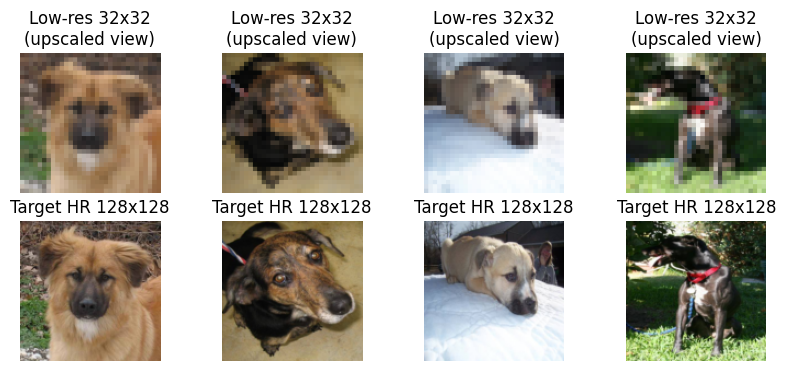

In [ ]:
from PIL import Image
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import torch.nn.functional as F
import matplotlib.pyplot as plt
import random

# Normalization for classifier models (ResNet-style)
classifier_normalize = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225],
)

train_transform_classifier = transforms.Compose([
    transforms.Resize((128,128)),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(brightness=0.15, contrast=0.15, saturation=0.15),
    transforms.ToTensor(),
    classifier_normalize,
])

test_transform_classifier = transforms.Compose([
    transforms.Resize((128,128)),
    transforms.ToTensor(),
    classifier_normalize,
])

# HR norm for GAN targets (-1 to 1), and inverse for display
hr_norm = transforms.Normalize(mean=[0.5,0.5,0.5], std=[0.5,0.5,0.5])
inv_hr_norm = lambda x: (x * 0.5 + 0.5).clamp(0,1)

# --------- Filter out corrupt images ---------

def is_valid_image(path):
    """
    Returns True if PIL can open+load the file successfully.
    Returns False for truncated / corrupted images.
    """
    try:
        with Image.open(path) as img:
            img.verify()  # header check
        # reopen and force load pixel data
        with Image.open(path) as img:
            img.load()
        return True
    except Exception:
        return False

full_ds = datasets.ImageFolder(DATA_ROOT)
class_names = full_ds.classes
print("Classes:", class_names)

clean_items = []
bad_items = []

for img_path, label in full_ds.imgs:
    if is_valid_image(img_path):
        clean_items.append((img_path, label))
    else:
        bad_items.append(img_path)

print("Total images from disk        :", len(full_ds.imgs))
print("Usable (passed validation)    :", len(clean_items))
print("Corrupted / unreadable images :", len(bad_items))
if len(bad_items) > 0:
    print("Examples of bad files:", bad_items[:5])

# --------- Train/test split (70/30) ---------

random.shuffle(clean_items)
n_total = len(clean_items)
n_train = int(TRAIN_SPLIT * n_total)
train_items = clean_items[:n_train]
test_items  = clean_items[n_train:]

print(f"\nAfter filtering corrupt images:")
print(f"Total usable images: {n_total}")
print(f"Train split:         {len(train_items)}")
print(f"Test split:          {len(test_items)}")

# --------- Dataset wrappers ---------

class ClassifierSubset(torch.utils.data.Dataset):
    """
    For classifier A/B.
    Returns:
        img (tensor normalized for ResNet)
        label (0=cat, 1=dog)
    """
    def __init__(self, items, transform):
        self.items = items
        self.transform = transform
    def __len__(self):
        return len(self.items)
    def __getitem__(self, idx):
        path, label = self.items[idx]
        img = datasets.folder.default_loader(path)  # PIL
        img = self.transform(img)
        return img, label

class SRPairDataset(torch.utils.data.Dataset):
    """
    For SRGAN training.
    Returns:
        lr : [0,1]  shape (3,32,32)
        hr : [-1,1] shape (3,128,128)
    We:
      - resize to 128x128 (HR)
      - downsample to 32x32 (LR)
      - normalize HR to [-1,1] for GAN loss
    """
    def __init__(self, items, augment=True):
        self.items = items
        self.augment = augment
        self.aug = transforms.RandomHorizontalFlip(p=0.5)
        self.hr_base = transforms.Compose([
            transforms.Resize((128,128)),
            transforms.ToTensor(),   # [0,1]
        ])
        self.lr_down = transforms.Resize((32,32), interpolation=transforms.InterpolationMode.BICUBIC)

    def __len__(self):
        return len(self.items)

    def __getitem__(self, idx):
        path, _ = self.items[idx]
        img = datasets.folder.default_loader(path)  # PIL
        if self.augment:
            img = self.aug(img)

        # high-res reference (target)
        hr = self.hr_base(img)      # [0,1], 3x128x128
        # low-res version fed to generator
        lr = self.lr_down(hr)       # [0,1], 3x32x32
        # normalize HR to [-1,1] for GAN
        hr = hr_norm(hr)
        return lr, hr

# --------- DataLoaders ---------

train_ds_classifier = ClassifierSubset(train_items, train_transform_classifier)
test_ds_classifier  = ClassifierSubset(test_items,  test_transform_classifier)
train_ds_srgan      = SRPairDataset(train_items, augment=True)

train_loader_classifier = DataLoader(
    train_ds_classifier,
    batch_size=BATCH_CLS,
    shuffle=True,
    num_workers=2,
    pin_memory=True,
)

test_loader_classifier = DataLoader(
    test_ds_classifier,
    batch_size=BATCH_CLS,
    shuffle=False,
    num_workers=2,
    pin_memory=True,
)

train_loader_srgan = DataLoader(
    train_ds_srgan,
    batch_size=BATCH_SRGAN,
    shuffle=True,
    num_workers=2,
    pin_memory=True,
)

print("\nDataLoaders ready:")
print("  train_loader_classifier batches:", len(train_loader_classifier))
print("  test_loader_classifier  batches:", len(test_loader_classifier))
print("  train_loader_srgan      batches:", len(train_loader_srgan))

# --------- Visual sanity check ---------

def show_lr_hr_samples(dataset, num=4):
    """
    Shows:
      - Low-res 32x32 (upsampled just for display so you can see blockiness)
      - High-res 128x128 ground truth target
    This satisfies:
      - Show scaled images
      - Show transformed samples
    """
    plt.figure(figsize=(10,4))
    for i in range(num):
        lr, hr = dataset[i]  # lr in [0,1], hr in [-1,1]
        hr_disp = inv_hr_norm(hr).permute(1,2,0).cpu().numpy()

        # Upsample LR to 128x128 just for visualization
        lr_up   = F.interpolate(lr.unsqueeze(0), size=(128,128), mode='nearest')[0]
        lr_disp = lr_up.permute(1,2,0).cpu().numpy()

        plt.subplot(2,num,i+1)
        plt.imshow(lr_disp)
        plt.title("Low-res 32x32\n(upscaled view)")
        plt.axis("off")

        plt.subplot(2,num,num+i+1)
        plt.imshow(hr_disp)
        plt.title("Target HR 128x128")
        plt.axis("off")
    plt.show()

show_lr_hr_samples(train_ds_srgan, num=4)


**Train classifier A (baseline, 128×128 real images)**

In [ ]:
def make_classifier(num_classes=2):
    model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
    for p in model.parameters():
        p.requires_grad = True  # fine-tune entire net
    in_feats = model.fc.in_features
    model.fc = nn.Linear(in_feats, num_classes)
    return model.to(device)

criterion_cls = nn.CrossEntropyLoss()

def train_classifier(model, train_loader, test_loader, epochs, save_prefix):
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    best_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(1, epochs+1):
        model.train()
        train_losses = []
        y_true_train, y_pred_train = [], []

        for xb, yb in train_loader:
            xb, yb = xb.to(device), yb.to(device)
            optimizer.zero_grad()
            logits = model(xb)
            loss = criterion_cls(logits, yb)
            loss.backward()
            optimizer.step()

            train_losses.append(loss.item())
            preds = torch.argmax(logits, dim=1)
            y_true_train.extend(yb.cpu().numpy())
            y_pred_train.extend(preds.cpu().numpy())

        train_acc  = accuracy_score(y_true_train, y_pred_train)
        train_loss = np.mean(train_losses)

        # evaluate
        model.eval()
        y_true, y_pred, y_prob = [], [], []
        with torch.no_grad():
            for xb, yb in test_loader:
                xb, yb = xb.to(device), yb.to(device)
                logits = model(xb)
                probs  = F.softmax(logits, dim=1)[:,1]
                preds  = torch.argmax(logits, dim=1)

                y_true.extend(yb.cpu().numpy())
                y_pred.extend(preds.cpu().numpy())
                y_prob.extend(probs.cpu().numpy())

        acc = accuracy_score(y_true, y_pred)
        f1  = f1_score(y_true, y_pred)
        try:
            auc = roc_auc_score(y_true, y_prob)
        except:
            auc = float('nan')

        print(f"[A Epoch {epoch}/{epochs}] "
              f"TrainLoss={train_loss:.4f} TrainAcc={train_acc:.3f} | "
              f"ValAcc={acc:.3f} F1={f1:.3f} AUC={auc:.3f}")

        # save checkpoint
        if epoch % SAVE_EVERY == 0 or epoch == epochs:
            save_checkpoint({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_acc': acc,
                'val_f1': f1,
                'val_auc': auc,
            }, os.path.join(CHECKPOINT_DIR, f"{save_prefix}_epoch{epoch}.pt"))

        if acc > best_acc:
            best_acc = acc
            best_wts = copy.deepcopy(model.state_dict())

    model.load_state_dict(best_wts)
    print(f"[A] Best Val Acc: {best_acc:.4f}")
    return model

model_A = make_classifier(num_classes=2)
model_A = train_classifier(model_A, train_loader_classifier, test_loader_classifier,
                           epochs=EPOCHS_CLS, save_prefix="modelA")


[A Epoch 1/20] TrainLoss=0.1526 TrainAcc=0.950 | ValAcc=0.981 F1=0.990 AUC=0.982
[A Epoch 2/20] TrainLoss=0.0286 TrainAcc=0.993 | ValAcc=0.983 F1=0.991 AUC=0.983
[A Epoch 3/20] TrainLoss=0.0195 TrainAcc=0.994 | ValAcc=0.986 F1=0.993 AUC=0.977
[A Epoch 4/20] TrainLoss=0.0144 TrainAcc=0.995 | ValAcc=0.986 F1=0.993 AUC=0.976
[A Epoch 5/20] TrainLoss=0.0083 TrainAcc=0.998 | ValAcc=0.982 F1=0.991 AUC=0.974
[A Epoch 6/20] TrainLoss=0.0062 TrainAcc=0.998 | ValAcc=0.988 F1=0.994 AUC=0.973
[A Epoch 7/20] TrainLoss=0.0075 TrainAcc=0.998 | ValAcc=0.987 F1=0.993 AUC=0.980
[A Epoch 8/20] TrainLoss=0.0044 TrainAcc=0.998 | ValAcc=0.982 F1=0.991 AUC=0.952
[A Epoch 9/20] TrainLoss=0.0073 TrainAcc=0.998 | ValAcc=0.985 F1=0.992 AUC=0.970
[A Epoch 10/20] TrainLoss=0.0022 TrainAcc=1.000 | ValAcc=0.990 F1=0.995 AUC=0.985
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/modelA_epoch10.pt
[A Epoch 11/20] TrainLoss=0.0051 TrainAcc=0.998 | ValAcc=0.981 F1=0.990 AUC=0.952
[A Epoch 12/20

**Define SRGAN (Generator, Discriminator, VGG)**

In [ ]:
from torchvision.models import vgg19, VGG19_Weights

class ResidualBlock(nn.Module):
    def __init__(self, nf=64):
        super().__init__()
        self.block = nn.Sequential(
            nn.Conv2d(nf, nf, 3, 1, 1),
            nn.BatchNorm2d(nf),
            nn.PReLU(),
            nn.Conv2d(nf, nf, 3, 1, 1),
            nn.BatchNorm2d(nf),
        )
    def forward(self, x):
        return x + self.block(x)

class UpsampleBlock(nn.Module):
    def __init__(self, in_c, scale=2):
        super().__init__()
        self.conv = nn.Conv2d(in_c, in_c*(scale**2), 3, 1, 1)
        self.ps   = nn.PixelShuffle(scale)
        self.prelu= nn.PReLU()
    def forward(self, x):
        return self.prelu(self.ps(self.conv(x)))

class GeneratorSRGAN(nn.Module):
    # input: LR [0,1], 3x32x32
    # output: SR [-1,1], 3x128x128
    def __init__(self, num_res_blocks=8, nf=64):
        super().__init__()
        self.entry = nn.Sequential(
            nn.Conv2d(3, nf, 9, 1, 4),
            nn.PReLU()
        )
        self.resblocks = nn.Sequential(*[ResidualBlock(nf) for _ in range(num_res_blocks)])
        self.mid = nn.Sequential(
            nn.Conv2d(nf, nf, 3, 1, 1),
            nn.BatchNorm2d(nf)
        )
        self.up1 = UpsampleBlock(nf, scale=2)  # 32 -> 64
        self.up2 = UpsampleBlock(nf, scale=2)  # 64 -> 128
        self.out = nn.Conv2d(nf, 3, 9, 1, 4)
    def forward(self, x):
        fe1 = self.entry(x)
        rb  = self.resblocks(fe1)
        fe2 = self.mid(rb)
        fe  = fe1 + fe2
        up  = self.up1(fe)
        up  = self.up2(up)
        out = torch.tanh(self.out(up))  # [-1,1]
        return out

class DiscriminatorSRGAN(nn.Module):
    def __init__(self):
        super().__init__()
        def block(in_c,out_c,stride):
            return nn.Sequential(
                nn.Conv2d(in_c,out_c,3,stride,1),
                nn.BatchNorm2d(out_c),
                nn.LeakyReLU(0.2, inplace=True)
            )
        layers = []
        layers += [
            nn.Conv2d(3,64,3,1,1),
            nn.LeakyReLU(0.2, inplace=True)
        ]
        layers += list(block(64,64,2))
        layers += list(block(64,128,1))
        layers += list(block(128,128,2))
        layers += list(block(128,256,1))
        layers += list(block(256,256,2))
        layers += list(block(256,512,1))
        layers += list(block(512,512,2))

        self.features = nn.Sequential(*layers)
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(512 * (128//16) * (128//16), 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024,1),
            nn.Sigmoid()
        )
    def forward(self, x):
        f = self.features(x)
        return self.classifier(f)

class VGGFeatureExtractor(nn.Module):
    # perceptual loss (VGG relu5_4-ish per SRGAN paper)
    def __init__(self):
        super().__init__()
        vgg = vgg19(weights=VGG19_Weights.IMAGENET1K_V1).features
        self.slice = nn.Sequential()
        for i in range(36):
            self.slice.add_module(str(i), vgg[i])
        for p in self.slice.parameters():
            p.requires_grad = False
    def forward(self, x):
        # SRGAN expects VGG features on normalized [0,1] images
        x = (x + 1.0) / 2.0  # [-1,1] -> [0,1]
        norm = transforms.Normalize(
            mean=[0.485,0.456,0.406],
            std=[0.229,0.224,0.225]
        ).to(device)
        x = norm(x)
        return self.slice(x)

G = GeneratorSRGAN().to(device)
D = DiscriminatorSRGAN().to(device)
vgg_feat = VGGFeatureExtractor().to(device)

print("Generator params (M):", sum(p.numel() for p in G.parameters())/1e6)
print("Discriminator params (M):", sum(p.numel() for p in D.parameters())/1e6)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


100%|██████████| 548M/548M [00:02<00:00, 224MB/s]


Generator params (M): 0.956558
Discriminator params (M): 38.245569


**Train SRGAN for 150 epochs**

SRGAN Epoch 1/150: 100%|██████████| 246/246 [00:14<00:00, 17.54it/s]

[SRGAN 1/150] G_loss=1.9258 D_loss=0.0441


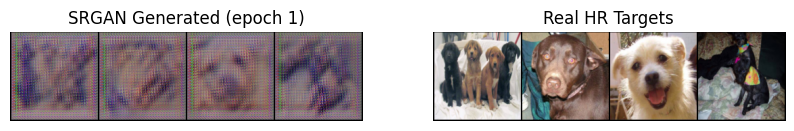

SRGAN Epoch 2/150: 100%|██████████| 246/246 [00:13<00:00, 18.83it/s]

[SRGAN 2/150] G_loss=1.8394 D_loss=0.0000


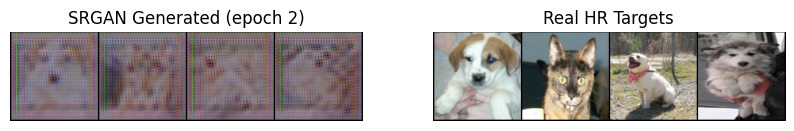

SRGAN Epoch 3/150: 100%|██████████| 246/246 [00:13<00:00, 18.82it/s]

[SRGAN 3/150] G_loss=1.8032 D_loss=0.0000


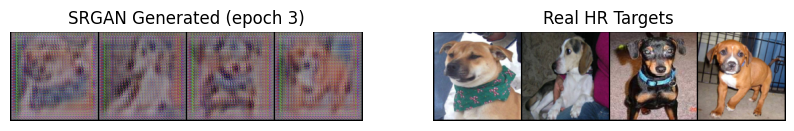

SRGAN Epoch 4/150: 100%|██████████| 246/246 [00:13<00:00, 18.65it/s]

[SRGAN 4/150] G_loss=1.7824 D_loss=0.0000


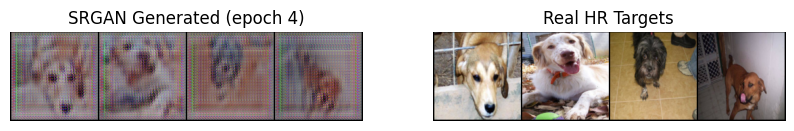

SRGAN Epoch 5/150: 100%|██████████| 246/246 [00:13<00:00, 18.71it/s]

[SRGAN 5/150] G_loss=1.7511 D_loss=0.0000


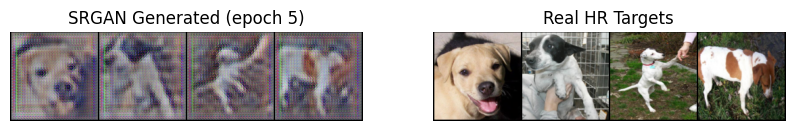

SRGAN Epoch 6/150: 100%|██████████| 246/246 [00:13<00:00, 18.79it/s]

[SRGAN 6/150] G_loss=1.6362 D_loss=0.0176


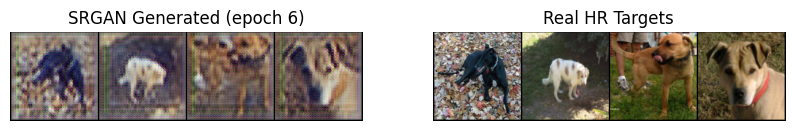

SRGAN Epoch 7/150: 100%|██████████| 246/246 [00:13<00:00, 18.74it/s]

[SRGAN 7/150] G_loss=1.4831 D_loss=0.0107


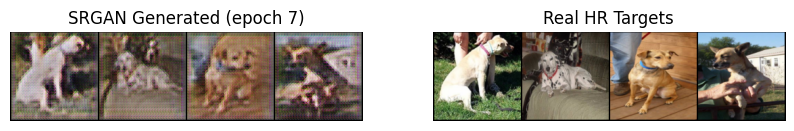

SRGAN Epoch 8/150: 100%|██████████| 246/246 [00:13<00:00, 18.58it/s]

[SRGAN 8/150] G_loss=1.3710 D_loss=0.0015


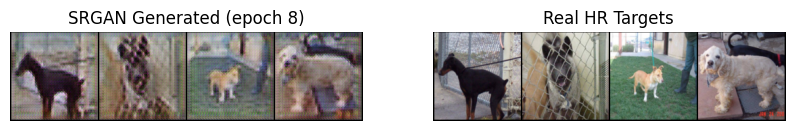

SRGAN Epoch 9/150: 100%|██████████| 246/246 [00:13<00:00, 18.73it/s]

[SRGAN 9/150] G_loss=1.3057 D_loss=0.0303


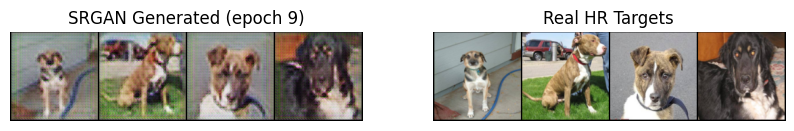

SRGAN Epoch 10/150: 100%|██████████| 246/246 [00:13<00:00, 18.65it/s]


[SRGAN 10/150] G_loss=1.2689 D_loss=0.0066
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch10.pt


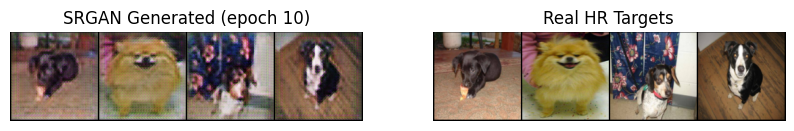

SRGAN Epoch 11/150: 100%|██████████| 246/246 [00:14<00:00, 17.35it/s]

[SRGAN 11/150] G_loss=1.2122 D_loss=0.0013


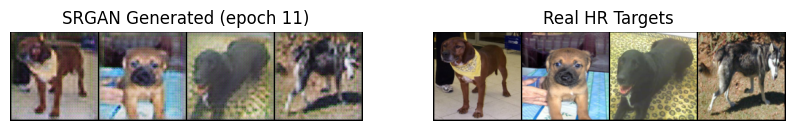

SRGAN Epoch 12/150: 100%|██████████| 246/246 [00:13<00:00, 18.36it/s]

[SRGAN 12/150] G_loss=1.1731 D_loss=0.0001


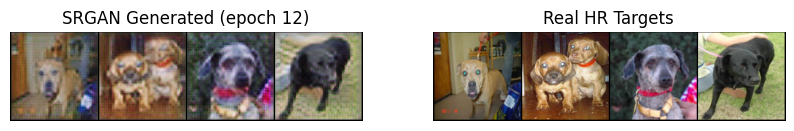

SRGAN Epoch 13/150: 100%|██████████| 246/246 [00:13<00:00, 18.79it/s]

[SRGAN 13/150] G_loss=1.1434 D_loss=0.0000


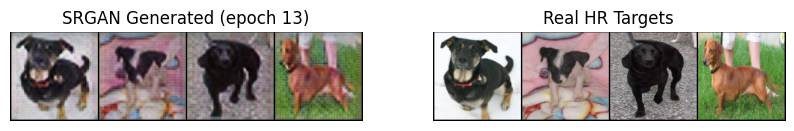

SRGAN Epoch 14/150: 100%|██████████| 246/246 [00:13<00:00, 18.62it/s]

[SRGAN 14/150] G_loss=1.1065 D_loss=0.0000


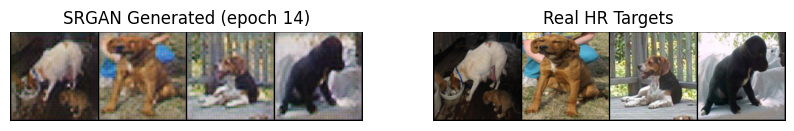

SRGAN Epoch 15/150: 100%|██████████| 246/246 [00:13<00:00, 18.67it/s]

[SRGAN 15/150] G_loss=1.0755 D_loss=0.0087


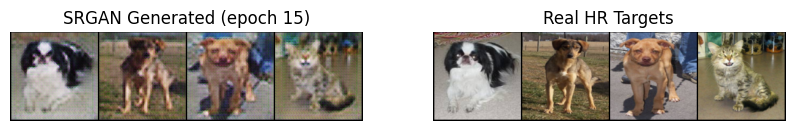

SRGAN Epoch 16/150: 100%|██████████| 246/246 [00:13<00:00, 18.72it/s]

[SRGAN 16/150] G_loss=1.0646 D_loss=0.0006


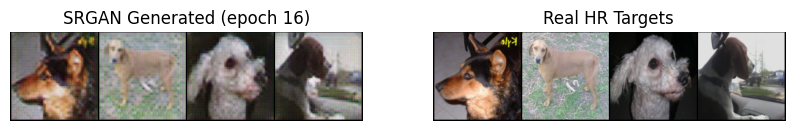

SRGAN Epoch 17/150: 100%|██████████| 246/246 [00:13<00:00, 18.55it/s]

[SRGAN 17/150] G_loss=1.0481 D_loss=0.0000


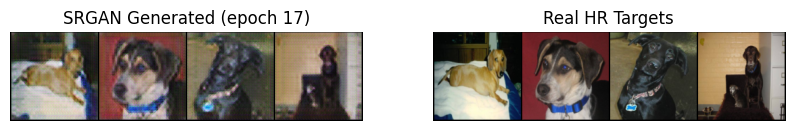

SRGAN Epoch 18/150: 100%|██████████| 246/246 [00:13<00:00, 18.67it/s]

[SRGAN 18/150] G_loss=1.0287 D_loss=0.0000


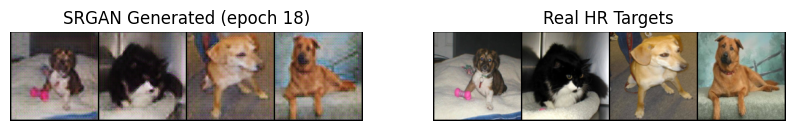

SRGAN Epoch 19/150: 100%|██████████| 246/246 [00:13<00:00, 18.50it/s]

[SRGAN 19/150] G_loss=1.0101 D_loss=0.0000


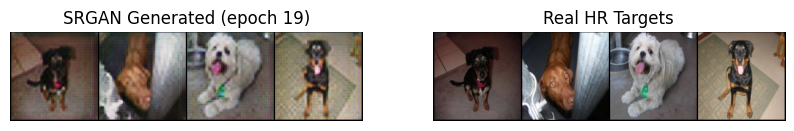

SRGAN Epoch 20/150: 100%|██████████| 246/246 [00:13<00:00, 18.63it/s]


[SRGAN 20/150] G_loss=0.9938 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch20.pt


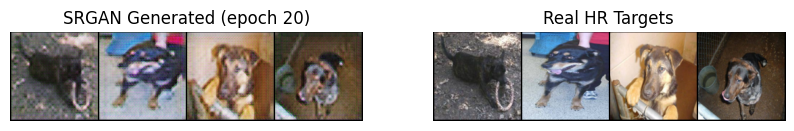

SRGAN Epoch 21/150: 100%|██████████| 246/246 [00:14<00:00, 17.31it/s]

[SRGAN 21/150] G_loss=0.9766 D_loss=0.0000


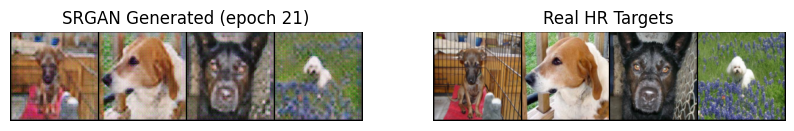

SRGAN Epoch 22/150: 100%|██████████| 246/246 [00:13<00:00, 18.66it/s]

[SRGAN 22/150] G_loss=0.9590 D_loss=0.0000


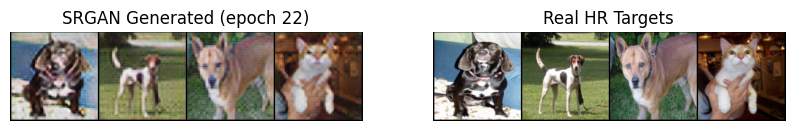

SRGAN Epoch 23/150: 100%|██████████| 246/246 [00:13<00:00, 18.73it/s]

[SRGAN 23/150] G_loss=0.9478 D_loss=0.0000


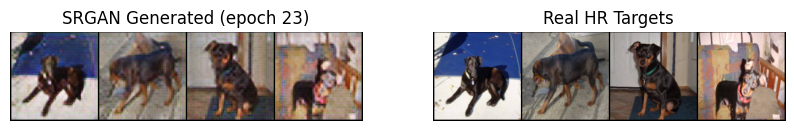

SRGAN Epoch 24/150: 100%|██████████| 246/246 [00:13<00:00, 18.69it/s]

[SRGAN 24/150] G_loss=0.9212 D_loss=0.0000


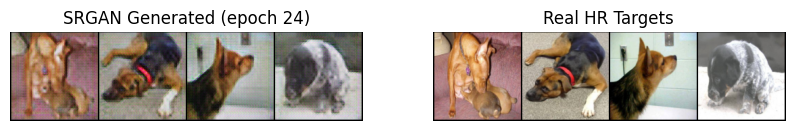

SRGAN Epoch 25/150: 100%|██████████| 246/246 [00:13<00:00, 18.55it/s]

[SRGAN 25/150] G_loss=0.9055 D_loss=0.0000


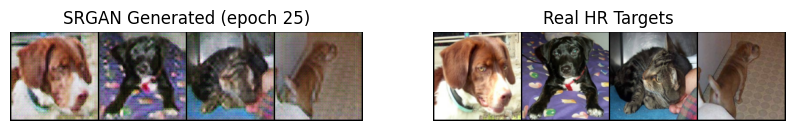

SRGAN Epoch 26/150: 100%|██████████| 246/246 [00:13<00:00, 18.57it/s]

[SRGAN 26/150] G_loss=0.9110 D_loss=0.0000


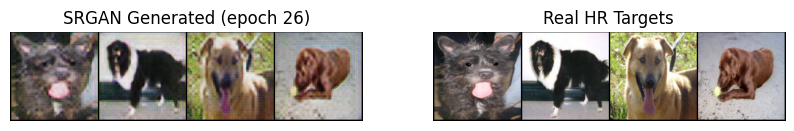

SRGAN Epoch 27/150: 100%|██████████| 246/246 [00:13<00:00, 18.56it/s]

[SRGAN 27/150] G_loss=0.9000 D_loss=0.0000


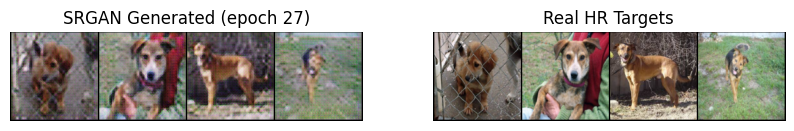

SRGAN Epoch 28/150: 100%|██████████| 246/246 [00:13<00:00, 18.56it/s]

[SRGAN 28/150] G_loss=0.8911 D_loss=0.0000


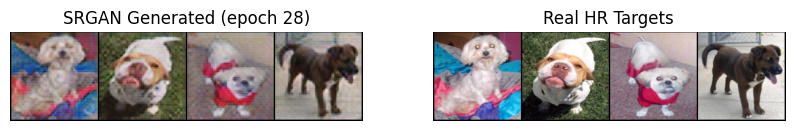

SRGAN Epoch 29/150: 100%|██████████| 246/246 [00:13<00:00, 18.59it/s]

[SRGAN 29/150] G_loss=0.8738 D_loss=0.0000


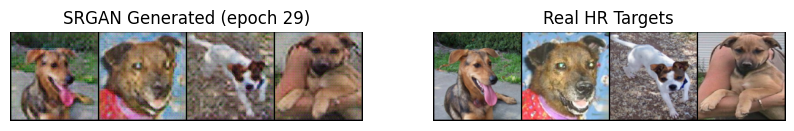

SRGAN Epoch 30/150: 100%|██████████| 246/246 [00:13<00:00, 18.71it/s]


[SRGAN 30/150] G_loss=0.8644 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch30.pt


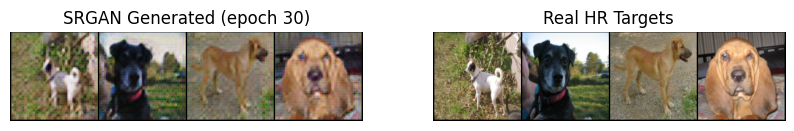

SRGAN Epoch 31/150: 100%|██████████| 246/246 [00:14<00:00, 17.33it/s]

[SRGAN 31/150] G_loss=0.8482 D_loss=0.0000


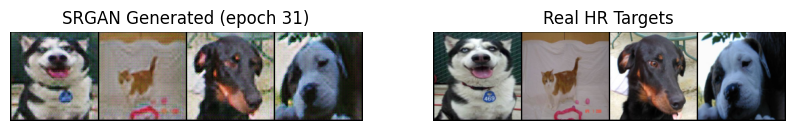

SRGAN Epoch 32/150: 100%|██████████| 246/246 [00:13<00:00, 18.36it/s]

[SRGAN 32/150] G_loss=0.8367 D_loss=0.0000


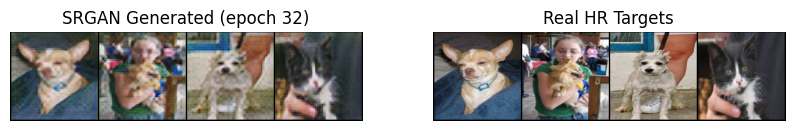

SRGAN Epoch 33/150: 100%|██████████| 246/246 [00:13<00:00, 18.52it/s]

[SRGAN 33/150] G_loss=0.8320 D_loss=0.0000


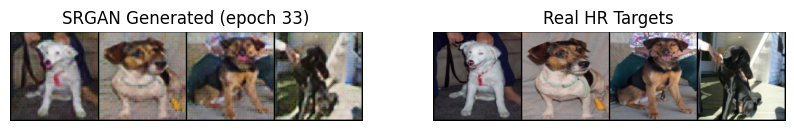

SRGAN Epoch 34/150: 100%|██████████| 246/246 [00:13<00:00, 18.63it/s]

[SRGAN 34/150] G_loss=0.8171 D_loss=0.0000


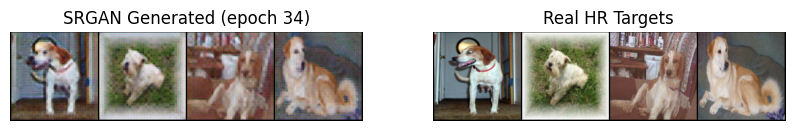

SRGAN Epoch 35/150: 100%|██████████| 246/246 [00:13<00:00, 18.58it/s]

[SRGAN 35/150] G_loss=0.8024 D_loss=0.0000


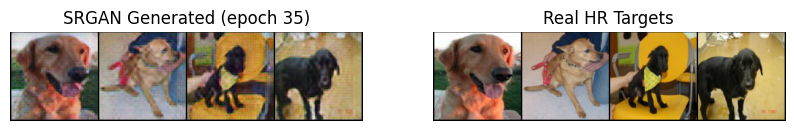

SRGAN Epoch 36/150: 100%|██████████| 246/246 [00:13<00:00, 18.66it/s]

[SRGAN 36/150] G_loss=0.7930 D_loss=0.0000


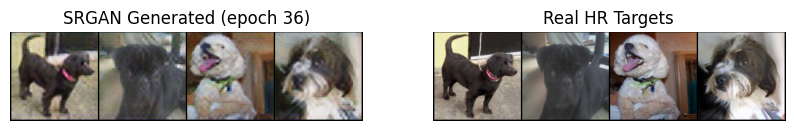

SRGAN Epoch 37/150: 100%|██████████| 246/246 [00:13<00:00, 18.44it/s]

[SRGAN 37/150] G_loss=0.7864 D_loss=0.0000


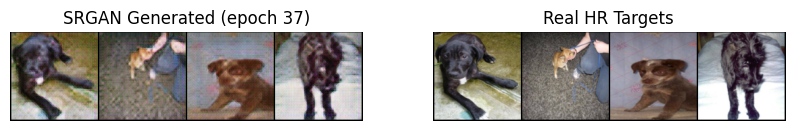

SRGAN Epoch 38/150: 100%|██████████| 246/246 [00:13<00:00, 18.53it/s]

[SRGAN 38/150] G_loss=0.7724 D_loss=0.0000


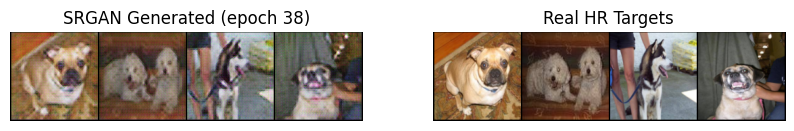

SRGAN Epoch 39/150: 100%|██████████| 246/246 [00:13<00:00, 18.52it/s]

[SRGAN 39/150] G_loss=0.7610 D_loss=0.0000


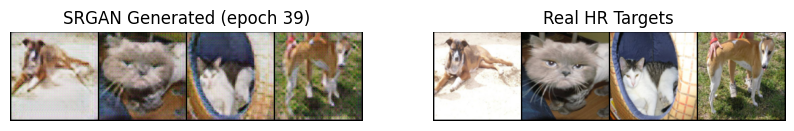

SRGAN Epoch 40/150: 100%|██████████| 246/246 [00:13<00:00, 18.61it/s]


[SRGAN 40/150] G_loss=0.7508 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch40.pt


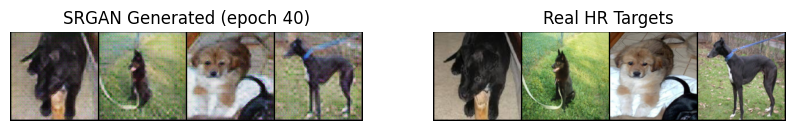

SRGAN Epoch 41/150: 100%|██████████| 246/246 [00:14<00:00, 17.21it/s]

[SRGAN 41/150] G_loss=0.7416 D_loss=0.0000


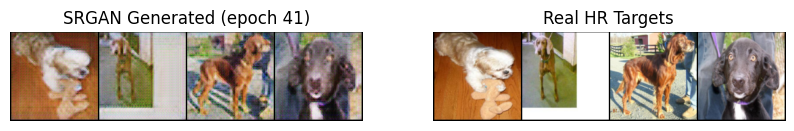

SRGAN Epoch 42/150: 100%|██████████| 246/246 [00:13<00:00, 18.58it/s]

[SRGAN 42/150] G_loss=0.7242 D_loss=0.1099


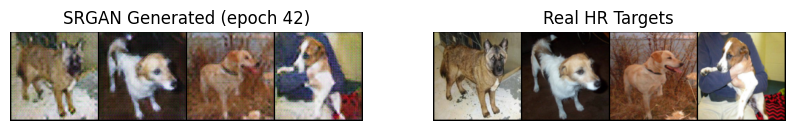

SRGAN Epoch 43/150: 100%|██████████| 246/246 [00:13<00:00, 18.56it/s]

[SRGAN 43/150] G_loss=0.6847 D_loss=0.0980


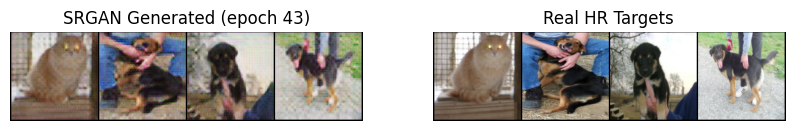

SRGAN Epoch 44/150: 100%|██████████| 246/246 [00:13<00:00, 18.59it/s]

[SRGAN 44/150] G_loss=0.6821 D_loss=0.0272


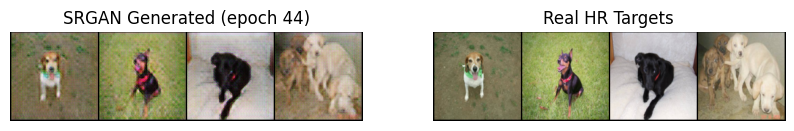

SRGAN Epoch 45/150: 100%|██████████| 246/246 [00:13<00:00, 18.56it/s]

[SRGAN 45/150] G_loss=0.6846 D_loss=0.0106


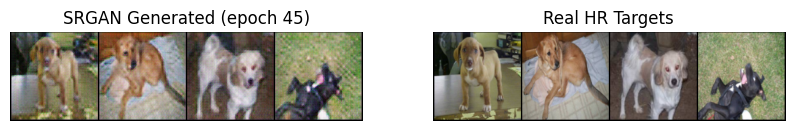

SRGAN Epoch 46/150: 100%|██████████| 246/246 [00:13<00:00, 18.70it/s]

[SRGAN 46/150] G_loss=0.6848 D_loss=0.0076


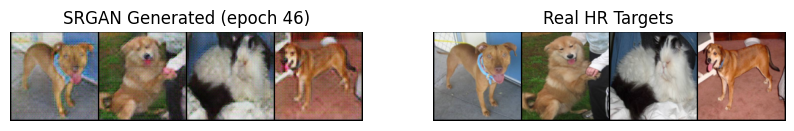

SRGAN Epoch 47/150: 100%|██████████| 246/246 [00:13<00:00, 18.39it/s]

[SRGAN 47/150] G_loss=0.6777 D_loss=0.0000


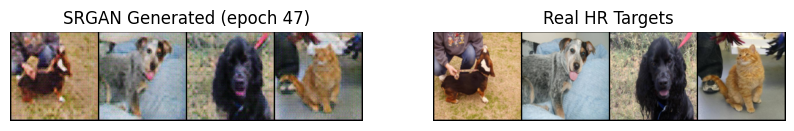

SRGAN Epoch 48/150: 100%|██████████| 246/246 [00:13<00:00, 18.61it/s]

[SRGAN 48/150] G_loss=0.6691 D_loss=0.0000


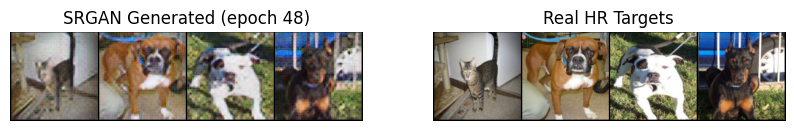

SRGAN Epoch 49/150: 100%|██████████| 246/246 [00:13<00:00, 18.52it/s]

[SRGAN 49/150] G_loss=0.6597 D_loss=0.0000


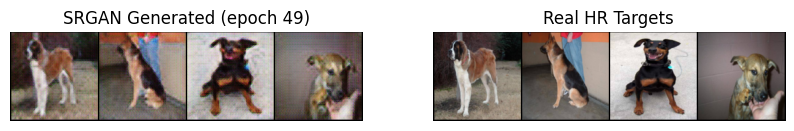

SRGAN Epoch 50/150: 100%|██████████| 246/246 [00:13<00:00, 18.59it/s]


[SRGAN 50/150] G_loss=0.6523 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch50.pt


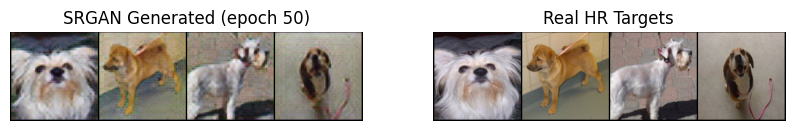

SRGAN Epoch 51/150: 100%|██████████| 246/246 [00:14<00:00, 17.10it/s]

[SRGAN 51/150] G_loss=0.6463 D_loss=0.0000


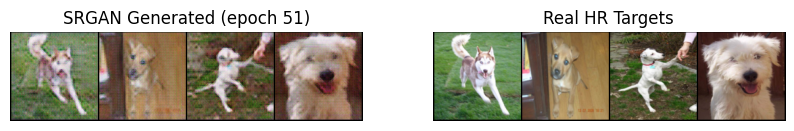

SRGAN Epoch 52/150: 100%|██████████| 246/246 [00:13<00:00, 18.43it/s]

[SRGAN 52/150] G_loss=0.6396 D_loss=0.0000


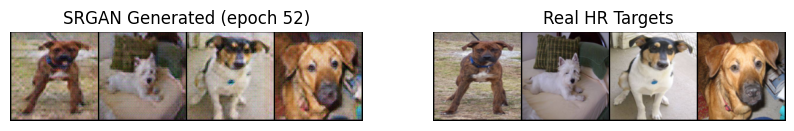

SRGAN Epoch 53/150: 100%|██████████| 246/246 [00:13<00:00, 18.54it/s]

[SRGAN 53/150] G_loss=0.6304 D_loss=0.0000


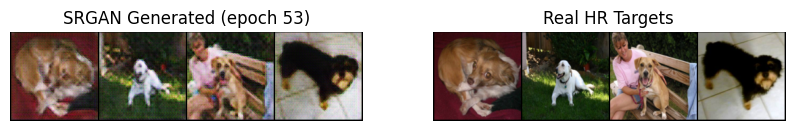

SRGAN Epoch 54/150: 100%|██████████| 246/246 [00:13<00:00, 18.68it/s]

[SRGAN 54/150] G_loss=0.6224 D_loss=0.0000


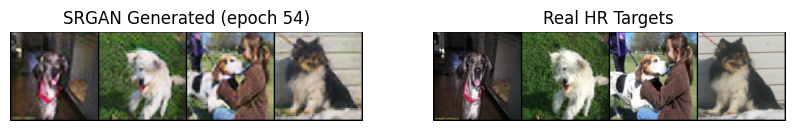

SRGAN Epoch 55/150: 100%|██████████| 246/246 [00:13<00:00, 18.61it/s]

[SRGAN 55/150] G_loss=0.6159 D_loss=0.0000


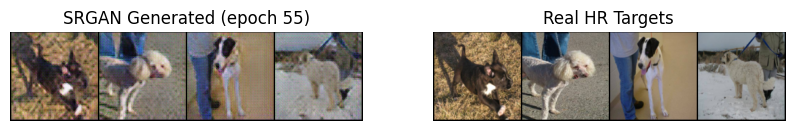

SRGAN Epoch 56/150: 100%|██████████| 246/246 [00:13<00:00, 18.60it/s]

[SRGAN 56/150] G_loss=0.6103 D_loss=0.0000


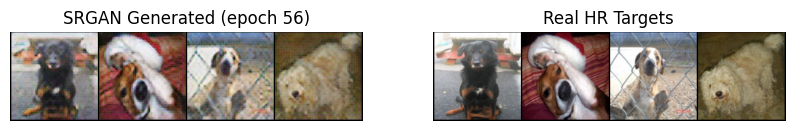

SRGAN Epoch 57/150: 100%|██████████| 246/246 [00:13<00:00, 18.64it/s]

[SRGAN 57/150] G_loss=0.6050 D_loss=0.0000


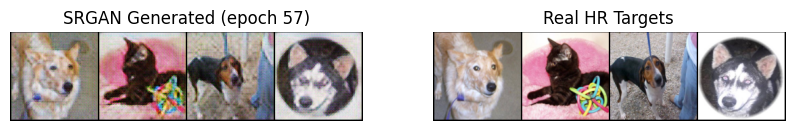

SRGAN Epoch 58/150: 100%|██████████| 246/246 [00:13<00:00, 18.67it/s]

[SRGAN 58/150] G_loss=0.5984 D_loss=0.0000


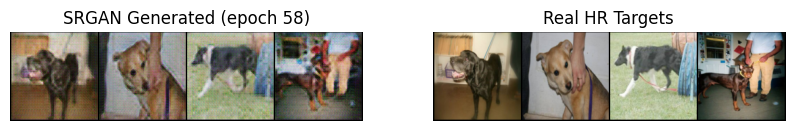

SRGAN Epoch 59/150: 100%|██████████| 246/246 [00:13<00:00, 18.57it/s]

[SRGAN 59/150] G_loss=0.5893 D_loss=0.0000


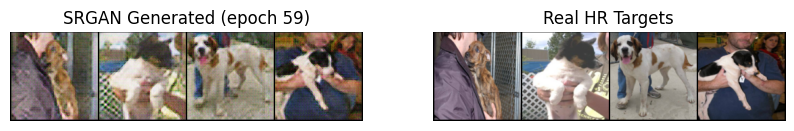

SRGAN Epoch 60/150: 100%|██████████| 246/246 [00:13<00:00, 18.59it/s]


[SRGAN 60/150] G_loss=0.5856 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch60.pt


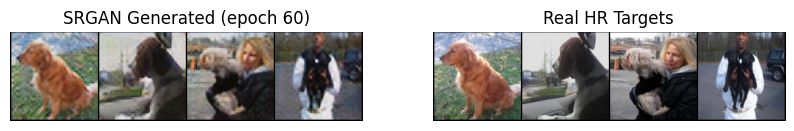

SRGAN Epoch 61/150: 100%|██████████| 246/246 [00:14<00:00, 17.11it/s]

[SRGAN 61/150] G_loss=0.5813 D_loss=0.0000


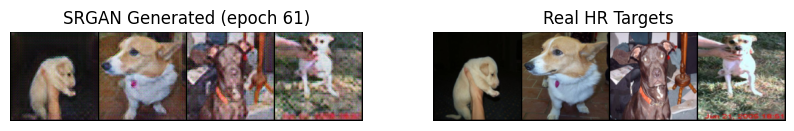

SRGAN Epoch 62/150: 100%|██████████| 246/246 [00:13<00:00, 18.46it/s]

[SRGAN 62/150] G_loss=0.5740 D_loss=0.0000


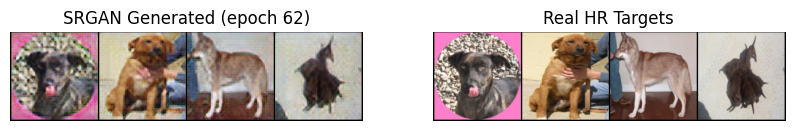

SRGAN Epoch 63/150: 100%|██████████| 246/246 [00:13<00:00, 18.64it/s]

[SRGAN 63/150] G_loss=0.5674 D_loss=0.0000


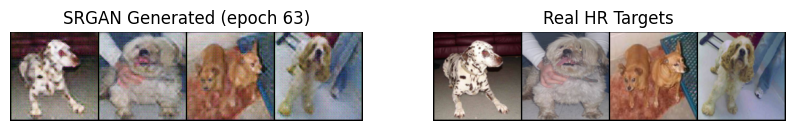

SRGAN Epoch 64/150: 100%|██████████| 246/246 [00:13<00:00, 18.74it/s]

[SRGAN 64/150] G_loss=0.5637 D_loss=0.0000


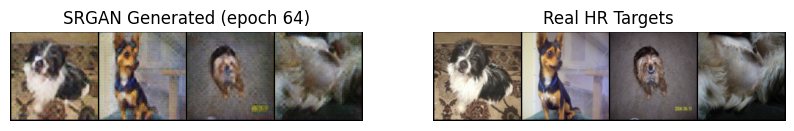

SRGAN Epoch 65/150: 100%|██████████| 246/246 [00:13<00:00, 18.61it/s]

[SRGAN 65/150] G_loss=0.5588 D_loss=0.0000


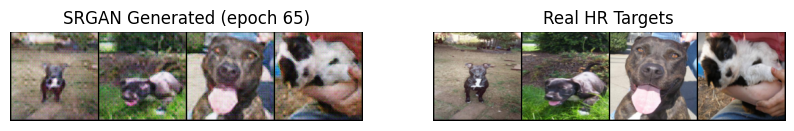

SRGAN Epoch 66/150: 100%|██████████| 246/246 [00:13<00:00, 18.62it/s]

[SRGAN 66/150] G_loss=0.5498 D_loss=0.0000


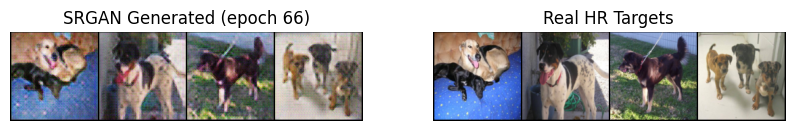

SRGAN Epoch 67/150: 100%|██████████| 246/246 [00:13<00:00, 18.64it/s]

[SRGAN 67/150] G_loss=0.5509 D_loss=0.0000


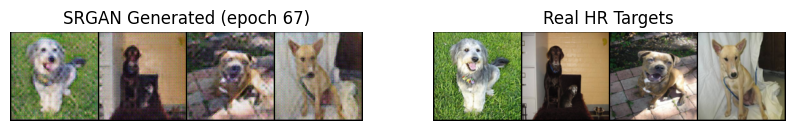

SRGAN Epoch 68/150: 100%|██████████| 246/246 [00:13<00:00, 18.53it/s]

[SRGAN 68/150] G_loss=0.5423 D_loss=0.0000


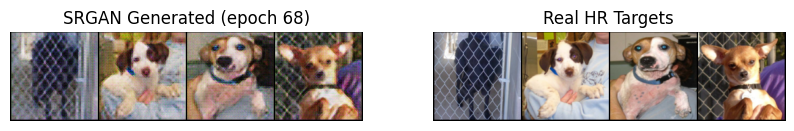

SRGAN Epoch 69/150: 100%|██████████| 246/246 [00:13<00:00, 18.68it/s]

[SRGAN 69/150] G_loss=0.5380 D_loss=0.0000


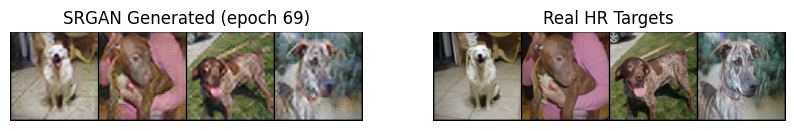

SRGAN Epoch 70/150: 100%|██████████| 246/246 [00:13<00:00, 18.71it/s]


[SRGAN 70/150] G_loss=0.5375 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch70.pt


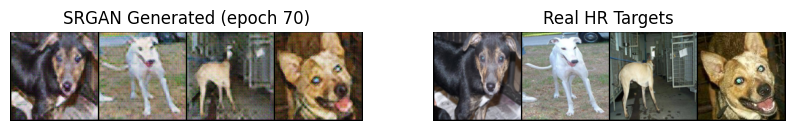

SRGAN Epoch 71/150: 100%|██████████| 246/246 [00:14<00:00, 17.20it/s]

[SRGAN 71/150] G_loss=0.5289 D_loss=0.0000


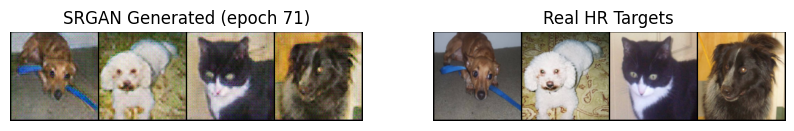

SRGAN Epoch 72/150: 100%|██████████| 246/246 [00:13<00:00, 18.56it/s]

[SRGAN 72/150] G_loss=0.5247 D_loss=0.0000


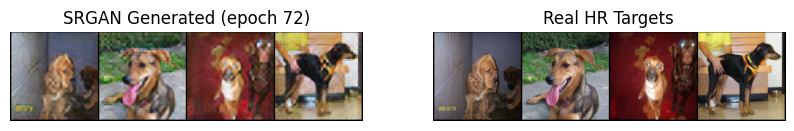

SRGAN Epoch 73/150: 100%|██████████| 246/246 [00:13<00:00, 18.56it/s]

[SRGAN 73/150] G_loss=0.5222 D_loss=0.0000


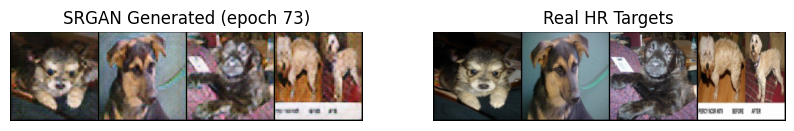

SRGAN Epoch 74/150: 100%|██████████| 246/246 [00:13<00:00, 18.67it/s]

[SRGAN 74/150] G_loss=0.5183 D_loss=0.0000


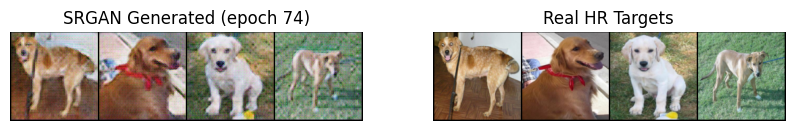

SRGAN Epoch 75/150: 100%|██████████| 246/246 [00:13<00:00, 18.51it/s]

[SRGAN 75/150] G_loss=0.5133 D_loss=0.0000


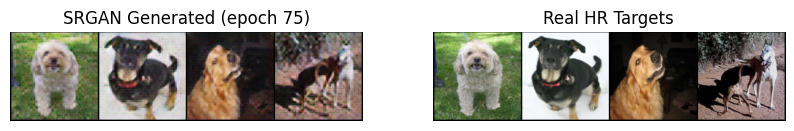

SRGAN Epoch 76/150: 100%|██████████| 246/246 [00:13<00:00, 18.61it/s]

[SRGAN 76/150] G_loss=0.5100 D_loss=0.0000


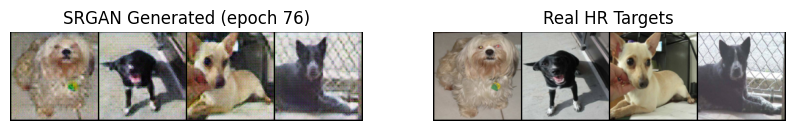

SRGAN Epoch 77/150: 100%|██████████| 246/246 [00:13<00:00, 18.62it/s]

[SRGAN 77/150] G_loss=0.5093 D_loss=0.0000


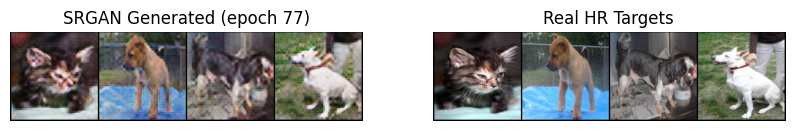

SRGAN Epoch 78/150: 100%|██████████| 246/246 [00:13<00:00, 18.61it/s]

[SRGAN 78/150] G_loss=0.5031 D_loss=0.0000


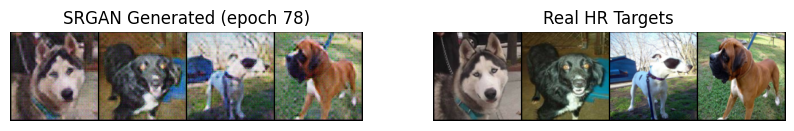

SRGAN Epoch 79/150: 100%|██████████| 246/246 [00:13<00:00, 18.55it/s]

[SRGAN 79/150] G_loss=0.4999 D_loss=0.0000


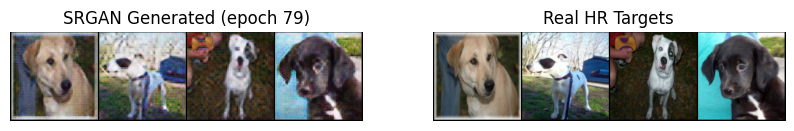

SRGAN Epoch 80/150: 100%|██████████| 246/246 [00:13<00:00, 18.59it/s]


[SRGAN 80/150] G_loss=0.4962 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch80.pt


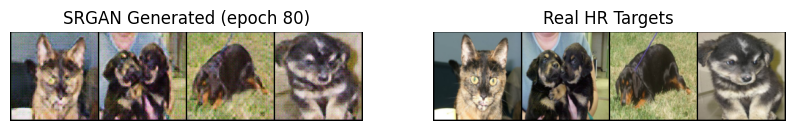

SRGAN Epoch 81/150: 100%|██████████| 246/246 [00:14<00:00, 17.21it/s]

[SRGAN 81/150] G_loss=0.4949 D_loss=0.0000


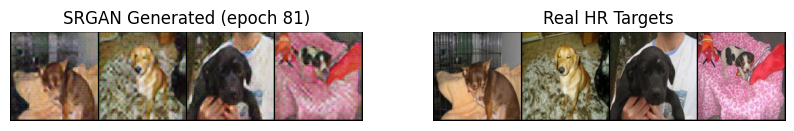

SRGAN Epoch 82/150: 100%|██████████| 246/246 [00:13<00:00, 18.62it/s]

[SRGAN 82/150] G_loss=0.4890 D_loss=0.0000


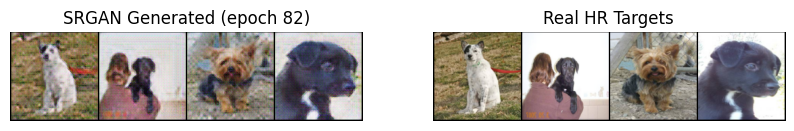

SRGAN Epoch 83/150: 100%|██████████| 246/246 [00:13<00:00, 18.59it/s]

[SRGAN 83/150] G_loss=0.4864 D_loss=0.0000


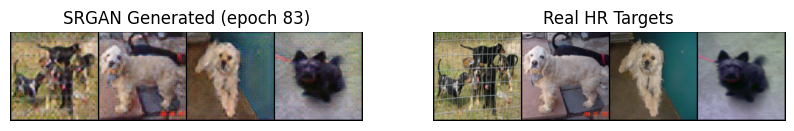

SRGAN Epoch 84/150: 100%|██████████| 246/246 [00:13<00:00, 18.61it/s]

[SRGAN 84/150] G_loss=0.4848 D_loss=0.0000


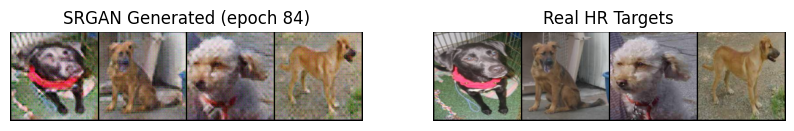

SRGAN Epoch 85/150: 100%|██████████| 246/246 [00:13<00:00, 18.62it/s]

[SRGAN 85/150] G_loss=0.4808 D_loss=0.0000


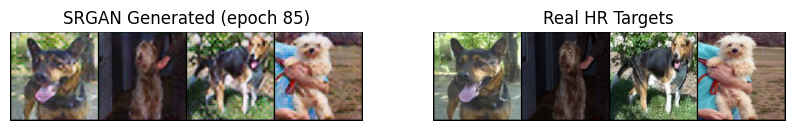

SRGAN Epoch 86/150: 100%|██████████| 246/246 [00:13<00:00, 18.64it/s]

[SRGAN 86/150] G_loss=0.4771 D_loss=0.0000


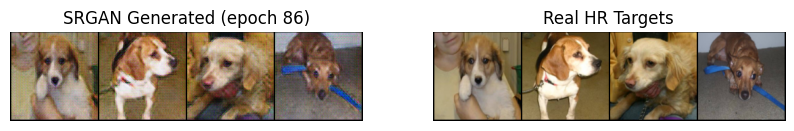

SRGAN Epoch 87/150: 100%|██████████| 246/246 [00:13<00:00, 18.62it/s]

[SRGAN 87/150] G_loss=0.4756 D_loss=0.0000


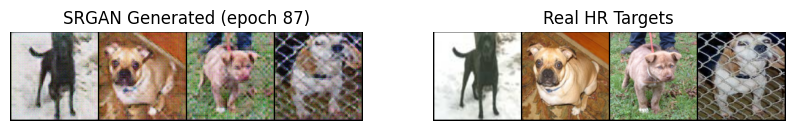

SRGAN Epoch 88/150: 100%|██████████| 246/246 [00:13<00:00, 18.64it/s]

[SRGAN 88/150] G_loss=0.4716 D_loss=0.0000


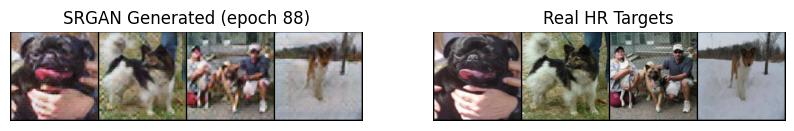

SRGAN Epoch 89/150: 100%|██████████| 246/246 [00:13<00:00, 18.64it/s]

[SRGAN 89/150] G_loss=0.4678 D_loss=0.0000


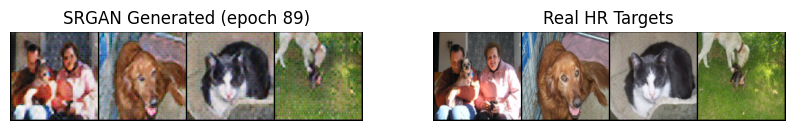

SRGAN Epoch 90/150: 100%|██████████| 246/246 [00:13<00:00, 18.67it/s]


[SRGAN 90/150] G_loss=0.4671 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch90.pt


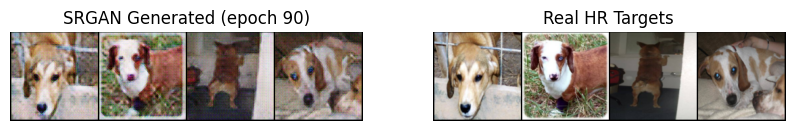

SRGAN Epoch 91/150: 100%|██████████| 246/246 [00:14<00:00, 17.22it/s]

[SRGAN 91/150] G_loss=0.4624 D_loss=0.0000


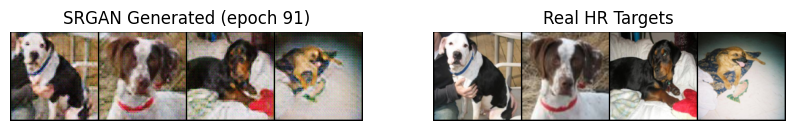

SRGAN Epoch 92/150: 100%|██████████| 246/246 [00:13<00:00, 18.51it/s]

[SRGAN 92/150] G_loss=0.4605 D_loss=0.0000


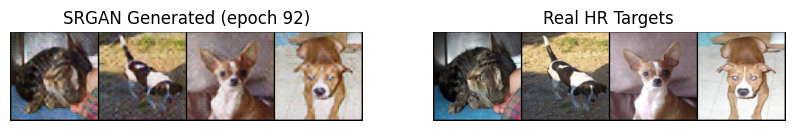

SRGAN Epoch 93/150: 100%|██████████| 246/246 [00:13<00:00, 18.61it/s]

[SRGAN 93/150] G_loss=0.4621 D_loss=0.0000


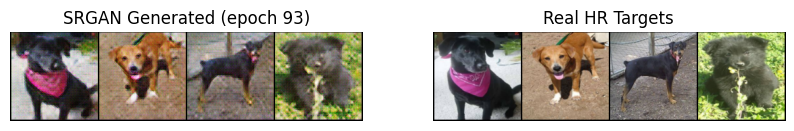

SRGAN Epoch 94/150: 100%|██████████| 246/246 [00:13<00:00, 18.58it/s]

[SRGAN 94/150] G_loss=0.4575 D_loss=0.0000


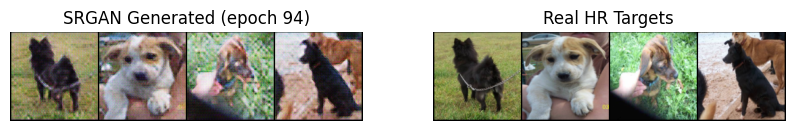

SRGAN Epoch 95/150: 100%|██████████| 246/246 [00:13<00:00, 18.52it/s]

[SRGAN 95/150] G_loss=0.4541 D_loss=0.0000


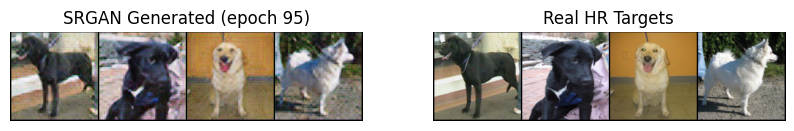

SRGAN Epoch 96/150: 100%|██████████| 246/246 [00:13<00:00, 18.53it/s]

[SRGAN 96/150] G_loss=0.4520 D_loss=0.0000


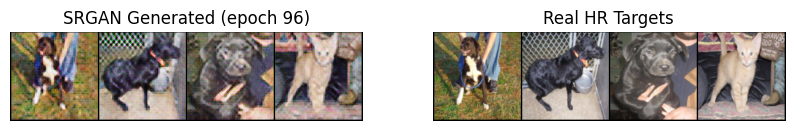

SRGAN Epoch 97/150: 100%|██████████| 246/246 [00:13<00:00, 18.62it/s]

[SRGAN 97/150] G_loss=0.4488 D_loss=0.0000


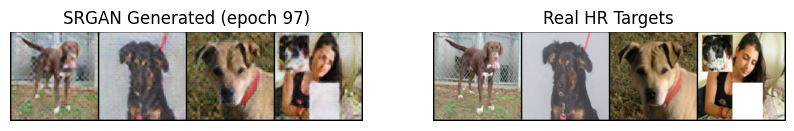

SRGAN Epoch 98/150: 100%|██████████| 246/246 [00:13<00:00, 18.59it/s]

[SRGAN 98/150] G_loss=0.4458 D_loss=0.0000


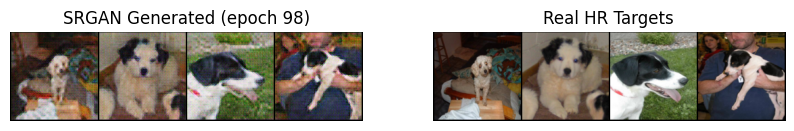

SRGAN Epoch 99/150: 100%|██████████| 246/246 [00:13<00:00, 18.60it/s]

[SRGAN 99/150] G_loss=0.4457 D_loss=0.0000


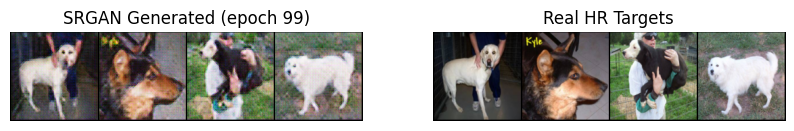

SRGAN Epoch 100/150: 100%|██████████| 246/246 [00:13<00:00, 18.49it/s]


[SRGAN 100/150] G_loss=0.4437 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch100.pt


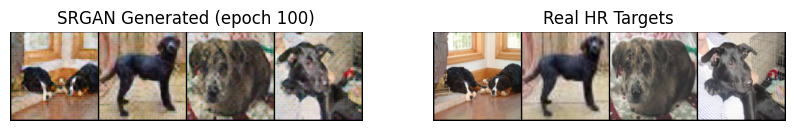

SRGAN Epoch 101/150: 100%|██████████| 246/246 [00:14<00:00, 17.26it/s]

[SRGAN 101/150] G_loss=0.4414 D_loss=0.0000


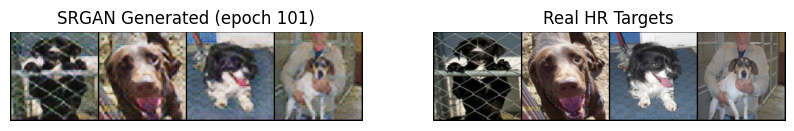

SRGAN Epoch 102/150: 100%|██████████| 246/246 [00:13<00:00, 18.30it/s]

[SRGAN 102/150] G_loss=0.4398 D_loss=0.0000


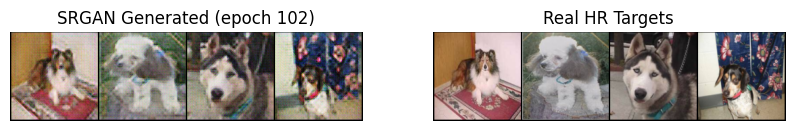

SRGAN Epoch 103/150: 100%|██████████| 246/246 [00:13<00:00, 18.37it/s]

[SRGAN 103/150] G_loss=0.4365 D_loss=0.0000


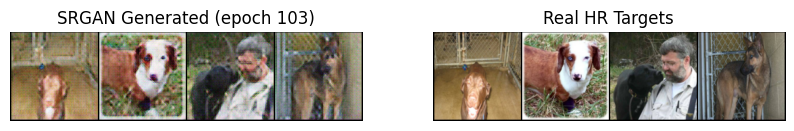

SRGAN Epoch 104/150: 100%|██████████| 246/246 [00:13<00:00, 18.33it/s]

[SRGAN 104/150] G_loss=0.4375 D_loss=0.0000


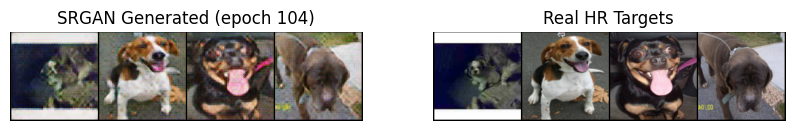

SRGAN Epoch 105/150: 100%|██████████| 246/246 [00:13<00:00, 18.38it/s]

[SRGAN 105/150] G_loss=0.4328 D_loss=0.0000


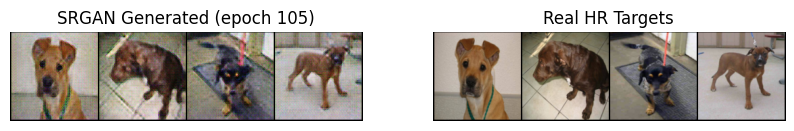

SRGAN Epoch 106/150: 100%|██████████| 246/246 [00:13<00:00, 18.46it/s]

[SRGAN 106/150] G_loss=0.4302 D_loss=0.0000


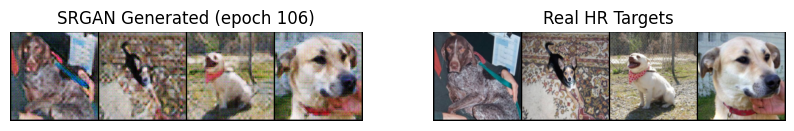

SRGAN Epoch 107/150: 100%|██████████| 246/246 [00:13<00:00, 18.61it/s]

[SRGAN 107/150] G_loss=0.4290 D_loss=0.0000


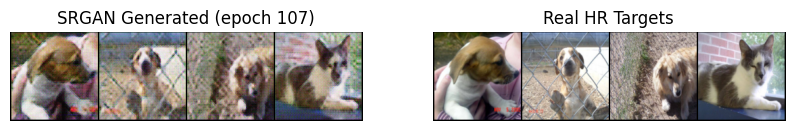

SRGAN Epoch 108/150: 100%|██████████| 246/246 [00:13<00:00, 18.48it/s]

[SRGAN 108/150] G_loss=0.4276 D_loss=0.0000


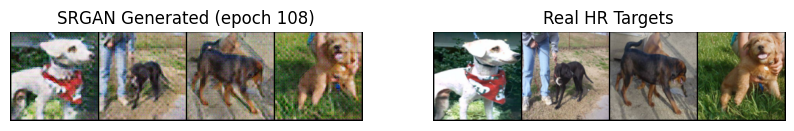

SRGAN Epoch 109/150: 100%|██████████| 246/246 [00:13<00:00, 18.63it/s]

[SRGAN 109/150] G_loss=0.4251 D_loss=0.0000


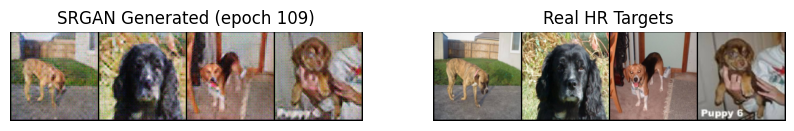

SRGAN Epoch 110/150: 100%|██████████| 246/246 [00:13<00:00, 18.65it/s]


[SRGAN 110/150] G_loss=0.4222 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch110.pt


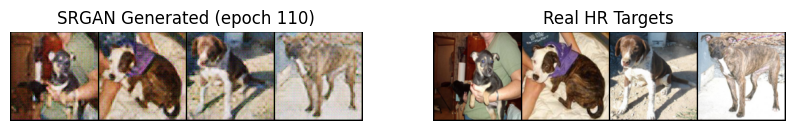

SRGAN Epoch 111/150: 100%|██████████| 246/246 [00:14<00:00, 17.34it/s]

[SRGAN 111/150] G_loss=0.4224 D_loss=0.0000


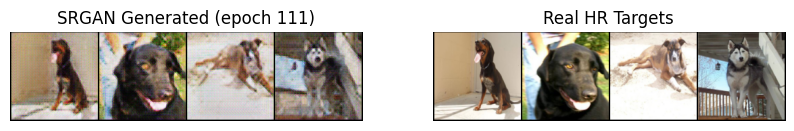

SRGAN Epoch 112/150: 100%|██████████| 246/246 [00:13<00:00, 18.44it/s]

[SRGAN 112/150] G_loss=0.4204 D_loss=0.0000


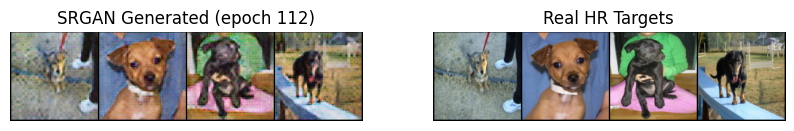

SRGAN Epoch 113/150: 100%|██████████| 246/246 [00:13<00:00, 18.52it/s]

[SRGAN 113/150] G_loss=0.4194 D_loss=0.0000


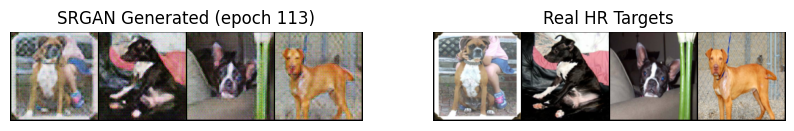

SRGAN Epoch 114/150: 100%|██████████| 246/246 [00:13<00:00, 18.75it/s]

[SRGAN 114/150] G_loss=0.4172 D_loss=0.0000


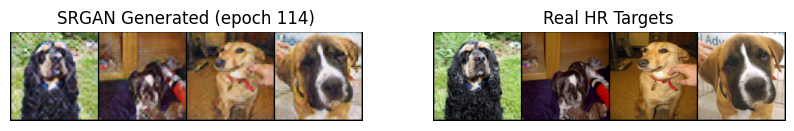

SRGAN Epoch 115/150: 100%|██████████| 246/246 [00:13<00:00, 18.55it/s]

[SRGAN 115/150] G_loss=0.4174 D_loss=0.0000


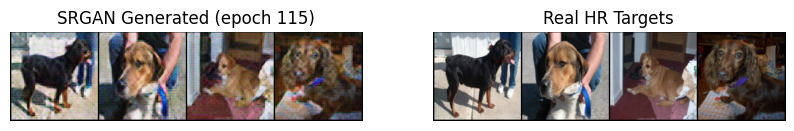

SRGAN Epoch 116/150: 100%|██████████| 246/246 [00:13<00:00, 18.57it/s]

[SRGAN 116/150] G_loss=0.4142 D_loss=0.0000


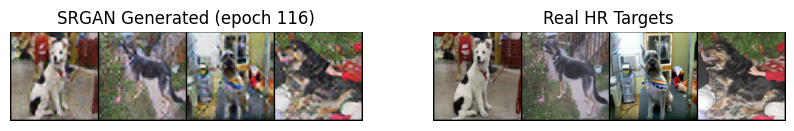

SRGAN Epoch 117/150: 100%|██████████| 246/246 [00:13<00:00, 18.60it/s]

[SRGAN 117/150] G_loss=0.4128 D_loss=0.0000


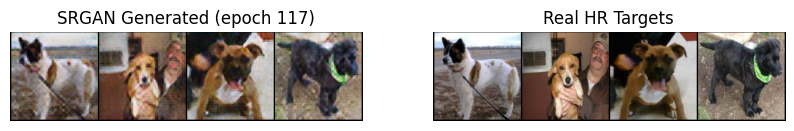

SRGAN Epoch 118/150: 100%|██████████| 246/246 [00:13<00:00, 18.65it/s]

[SRGAN 118/150] G_loss=0.4128 D_loss=0.0000


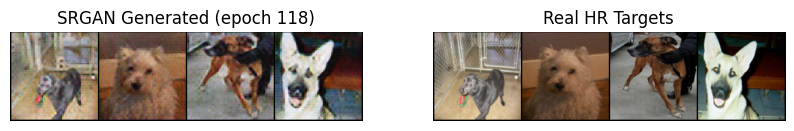

SRGAN Epoch 119/150: 100%|██████████| 246/246 [00:13<00:00, 18.44it/s]

[SRGAN 119/150] G_loss=0.4093 D_loss=0.0000


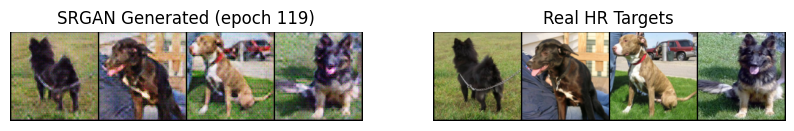

SRGAN Epoch 120/150: 100%|██████████| 246/246 [00:13<00:00, 18.60it/s]


[SRGAN 120/150] G_loss=0.4087 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch120.pt


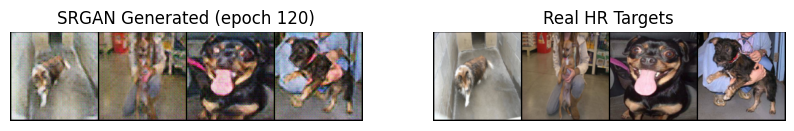

SRGAN Epoch 121/150: 100%|██████████| 246/246 [00:14<00:00, 17.17it/s]

[SRGAN 121/150] G_loss=0.4069 D_loss=0.0000


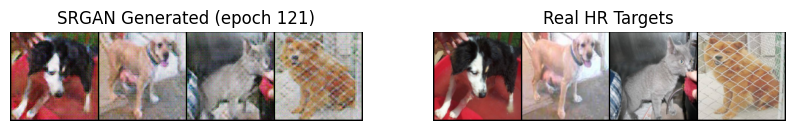

SRGAN Epoch 122/150: 100%|██████████| 246/246 [00:13<00:00, 18.52it/s]

[SRGAN 122/150] G_loss=0.4019 D_loss=0.0000


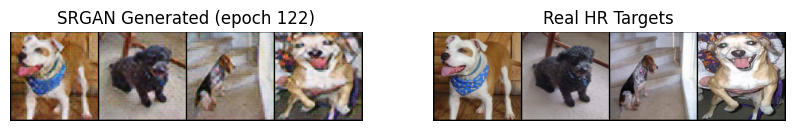

SRGAN Epoch 123/150: 100%|██████████| 246/246 [00:13<00:00, 18.53it/s]

[SRGAN 123/150] G_loss=0.4009 D_loss=0.0000


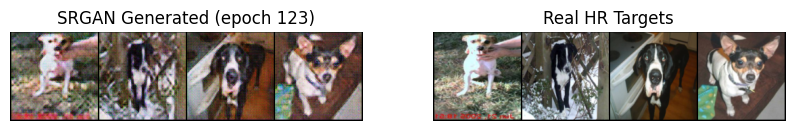

SRGAN Epoch 124/150: 100%|██████████| 246/246 [00:13<00:00, 18.49it/s]

[SRGAN 124/150] G_loss=0.4008 D_loss=0.0000


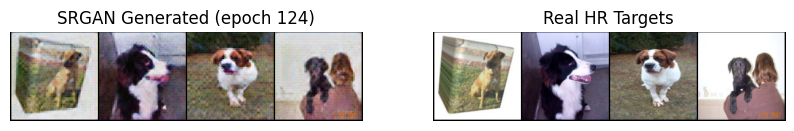

SRGAN Epoch 125/150: 100%|██████████| 246/246 [00:13<00:00, 18.63it/s]

[SRGAN 125/150] G_loss=0.4017 D_loss=0.0000


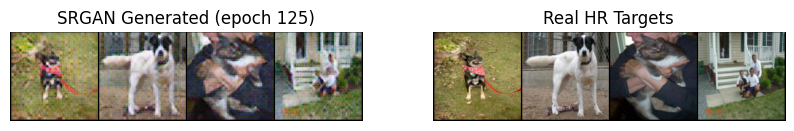

SRGAN Epoch 126/150: 100%|██████████| 246/246 [00:13<00:00, 18.55it/s]

[SRGAN 126/150] G_loss=0.3975 D_loss=0.0000


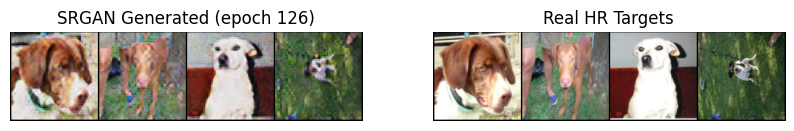

SRGAN Epoch 127/150: 100%|██████████| 246/246 [00:13<00:00, 18.64it/s]

[SRGAN 127/150] G_loss=0.3984 D_loss=0.0000


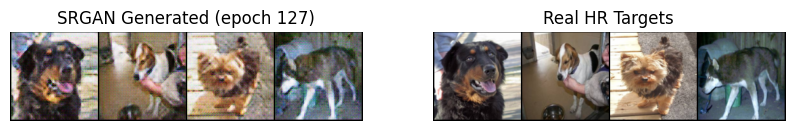

SRGAN Epoch 128/150: 100%|██████████| 246/246 [00:13<00:00, 18.64it/s]

[SRGAN 128/150] G_loss=0.3934 D_loss=0.0000


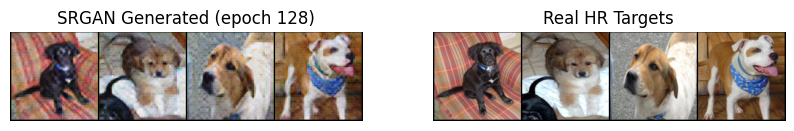

SRGAN Epoch 129/150: 100%|██████████| 246/246 [00:13<00:00, 18.56it/s]

[SRGAN 129/150] G_loss=0.3958 D_loss=0.0000


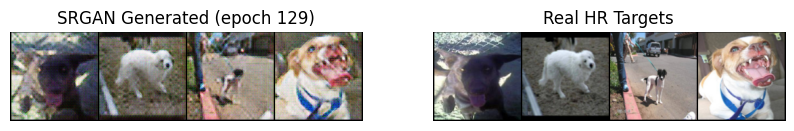

SRGAN Epoch 130/150: 100%|██████████| 246/246 [00:13<00:00, 18.54it/s]


[SRGAN 130/150] G_loss=0.3946 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch130.pt


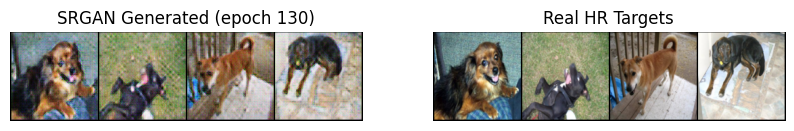

SRGAN Epoch 131/150: 100%|██████████| 246/246 [00:14<00:00, 17.10it/s]

[SRGAN 131/150] G_loss=0.3959 D_loss=0.0000


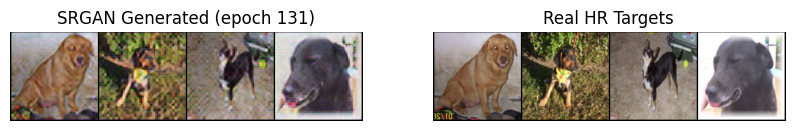

SRGAN Epoch 132/150: 100%|██████████| 246/246 [00:13<00:00, 18.39it/s]

[SRGAN 132/150] G_loss=0.3938 D_loss=0.0000


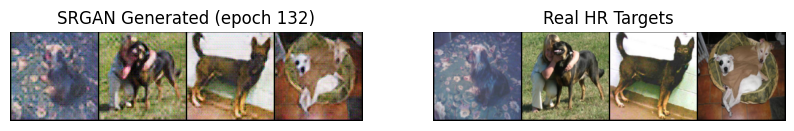

SRGAN Epoch 133/150: 100%|██████████| 246/246 [00:13<00:00, 18.60it/s]

[SRGAN 133/150] G_loss=0.3919 D_loss=0.0000


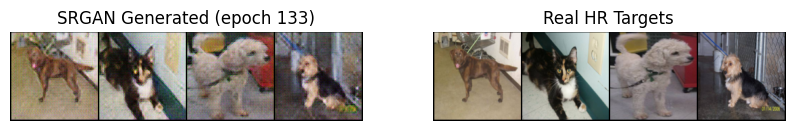

SRGAN Epoch 134/150: 100%|██████████| 246/246 [00:13<00:00, 18.56it/s]

[SRGAN 134/150] G_loss=0.3878 D_loss=0.0000


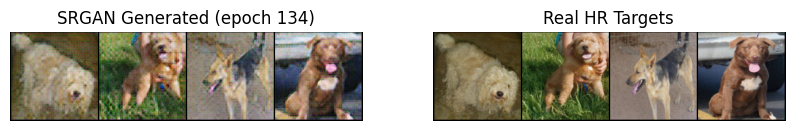

SRGAN Epoch 135/150: 100%|██████████| 246/246 [00:13<00:00, 18.52it/s]

[SRGAN 135/150] G_loss=0.3867 D_loss=0.0000


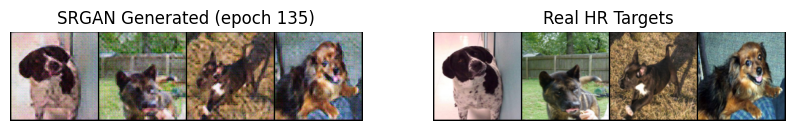

SRGAN Epoch 136/150: 100%|██████████| 246/246 [00:13<00:00, 18.55it/s]

[SRGAN 136/150] G_loss=0.3857 D_loss=0.0000


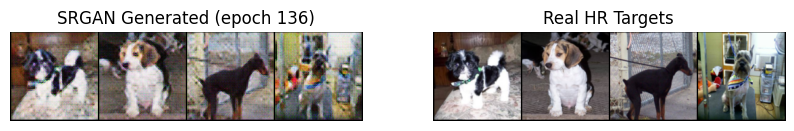

SRGAN Epoch 137/150: 100%|██████████| 246/246 [00:13<00:00, 18.66it/s]

[SRGAN 137/150] G_loss=0.3874 D_loss=0.0000


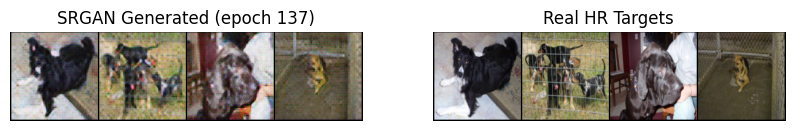

SRGAN Epoch 138/150: 100%|██████████| 246/246 [00:13<00:00, 18.48it/s]

[SRGAN 138/150] G_loss=0.3858 D_loss=0.0000


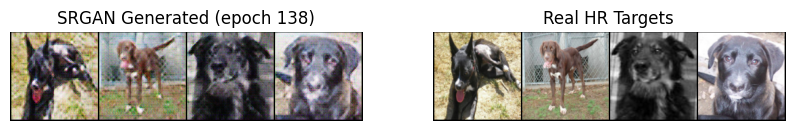

SRGAN Epoch 139/150: 100%|██████████| 246/246 [00:13<00:00, 18.42it/s]

[SRGAN 139/150] G_loss=0.3829 D_loss=0.0000


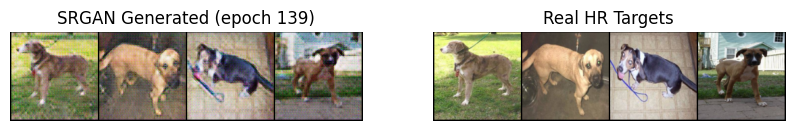

SRGAN Epoch 140/150: 100%|██████████| 246/246 [00:13<00:00, 18.49it/s]


[SRGAN 140/150] G_loss=0.3840 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch140.pt


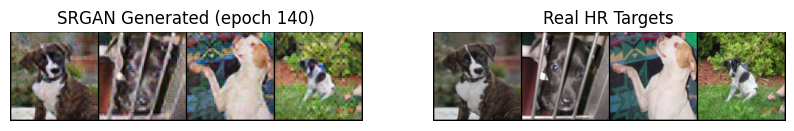

SRGAN Epoch 141/150: 100%|██████████| 246/246 [00:14<00:00, 17.16it/s]

[SRGAN 141/150] G_loss=0.3824 D_loss=0.0000


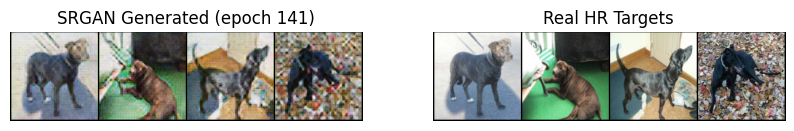

SRGAN Epoch 142/150: 100%|██████████| 246/246 [00:13<00:00, 18.29it/s]

[SRGAN 142/150] G_loss=0.3821 D_loss=0.0000


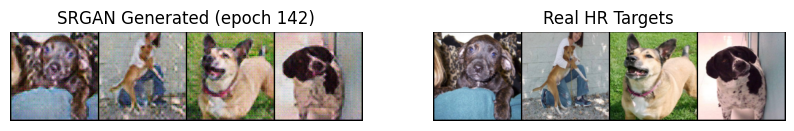

SRGAN Epoch 143/150: 100%|██████████| 246/246 [00:13<00:00, 18.45it/s]

[SRGAN 143/150] G_loss=0.3803 D_loss=0.0000


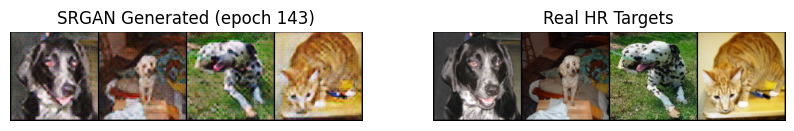

SRGAN Epoch 144/150: 100%|██████████| 246/246 [00:13<00:00, 18.52it/s]

[SRGAN 144/150] G_loss=0.3785 D_loss=0.0000


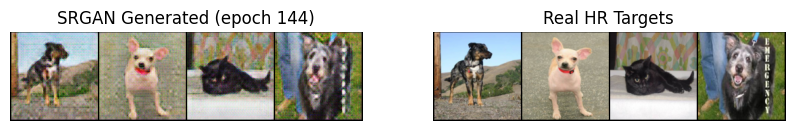

SRGAN Epoch 145/150: 100%|██████████| 246/246 [00:13<00:00, 18.62it/s]

[SRGAN 145/150] G_loss=0.3770 D_loss=0.0000


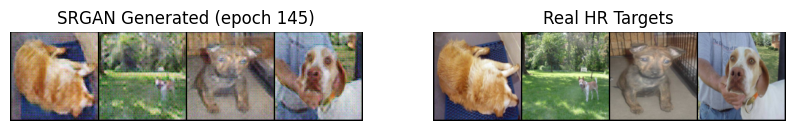

SRGAN Epoch 146/150: 100%|██████████| 246/246 [00:13<00:00, 18.57it/s]

[SRGAN 146/150] G_loss=0.3767 D_loss=0.0000


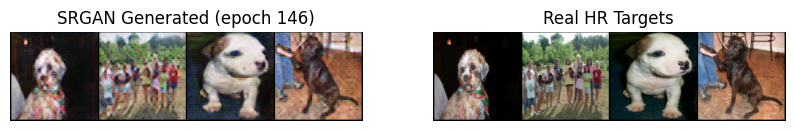

SRGAN Epoch 147/150: 100%|██████████| 246/246 [00:13<00:00, 18.41it/s]

[SRGAN 147/150] G_loss=0.3756 D_loss=0.0000


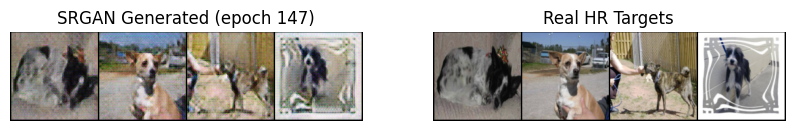

SRGAN Epoch 148/150: 100%|██████████| 246/246 [00:13<00:00, 18.58it/s]

[SRGAN 148/150] G_loss=0.3718 D_loss=0.0000


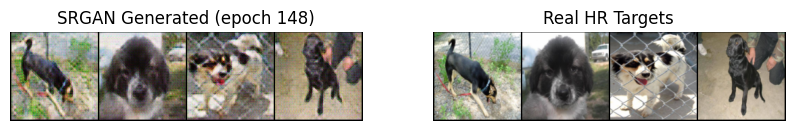

SRGAN Epoch 149/150: 100%|██████████| 246/246 [00:13<00:00, 18.54it/s]

[SRGAN 149/150] G_loss=0.3726 D_loss=0.0000


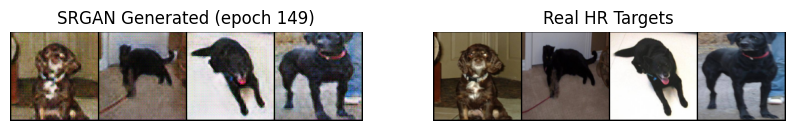

SRGAN Epoch 150/150: 100%|██████████| 246/246 [00:13<00:00, 18.73it/s]


[SRGAN 150/150] G_loss=0.3729 D_loss=0.0000
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/srgan_epoch150.pt


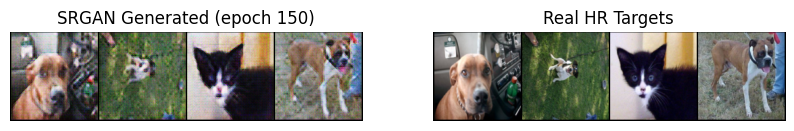

In [ ]:
bce = nn.BCELoss()
mse = nn.MSELoss()

opt_G = optim.Adam(G.parameters(), lr=1e-4, betas=(0.9,0.999))
opt_D = optim.Adam(D.parameters(), lr=1e-4, betas=(0.9,0.999))

def train_srgan(train_loader, epochs):
    G.train()
    D.train()
    for epoch in range(1, epochs+1):
        g_losses, d_losses = [], []

        for lr_img, hr_img in tqdm(train_loader, desc=f"SRGAN Epoch {epoch}/{epochs}"):
            lr_img = lr_img.to(device)  # [0,1]  32x32
            hr_img = hr_img.to(device)  # [-1,1] 128x128

            # ---- Train D ----
            with torch.no_grad():
                fake_hr = G(lr_img)

            D.zero_grad()
            real_out = D(hr_img)
            fake_out = D(fake_hr.detach())

            real_label = torch.ones_like(real_out, device=device)
            fake_label = torch.zeros_like(fake_out, device=device)

            d_loss_real = bce(real_out, real_label)
            d_loss_fake = bce(fake_out, fake_label)
            d_loss = d_loss_real + d_loss_fake
            d_loss.backward()
            opt_D.step()

            # ---- Train G ----
            G.zero_grad()
            fake_hr = G(lr_img)
            fake_out = D(fake_hr)

            adv_loss = bce(fake_out, real_label)
            feat_real = vgg_feat(hr_img).detach()
            feat_fake = vgg_feat(fake_hr)
            content_loss = mse(feat_fake, feat_real)
            pixel_loss = mse(fake_hr, hr_img)

            # SRGAN weighting
            g_loss = content_loss + 1e-3 * adv_loss + 0.01 * pixel_loss
            g_loss.backward()
            opt_G.step()

            g_losses.append(g_loss.item())
            d_losses.append(d_loss.item())

        print(f"[SRGAN {epoch}/{epochs}] G_loss={np.mean(g_losses):.4f} D_loss={np.mean(d_losses):.4f}")

        # checkpoint
        if epoch % SAVE_EVERY == 0 or epoch == epochs:
            save_checkpoint({
                'epoch': epoch,
                'G_state_dict': G.state_dict(),
                'D_state_dict': D.state_dict(),
                'opt_G': opt_G.state_dict(),
                'opt_D': opt_D.state_dict(),
                'g_loss': np.mean(g_losses),
                'd_loss': np.mean(d_losses),
            }, os.path.join(CHECKPOINT_DIR, f"srgan_epoch{epoch}.pt"))

        # visualize progress
        with torch.no_grad():
            lr_batch, hr_batch = next(iter(train_loader))
            lr_batch = lr_batch.to(device)
            hr_batch = hr_batch.to(device)
            fake_batch = G(lr_batch)

            fake_disp = (fake_batch.clamp(-1,1) + 1)/2
            hr_disp   = (hr_batch.clamp(-1,1) + 1)/2

            grid_fake = vutils.make_grid(fake_disp[:4], nrow=4)
            grid_hr   = vutils.make_grid(hr_disp[:4], nrow=4)

            plt.figure(figsize=(10,4))
            plt.subplot(1,2,1)
            plt.imshow(np.transpose(grid_fake.cpu().numpy(), (1,2,0)))
            plt.title(f"SRGAN Generated (epoch {epoch})")
            plt.axis("off")

            plt.subplot(1,2,2)
            plt.imshow(np.transpose(grid_hr.cpu().numpy(), (1,2,0)))
            plt.title("Real HR Targets")
            plt.axis("off")
            plt.show()

train_srgan(train_loader_srgan, epochs=EPOCHS_SRGAN)

**Train classifier B using SRGAN outputs**

In [ ]:
class SRGANAugmentedClassifierDataset(torch.utils.data.Dataset):
    """
    For each training sample:
      With probability p_gen, replace the real 128x128 image
      with SRGAN's super-res (32->128),
      otherwise use normal transform.
    """
    def __init__(self, items, p_gen, transform_real, generator):
        self.items = items
        self.p_gen = p_gen
        self.transform_real = transform_real
        self.gen = generator.eval().to(device)

        self.resize128 = transforms.Resize((128,128))
        self.tensor_only = transforms.ToTensor()
        self.lr_down = transforms.Resize((32,32), interpolation=transforms.InterpolationMode.BICUBIC)

        for p in self.gen.parameters():
            p.requires_grad = False

    def __len__(self):
        return len(self.items)

    def __getitem__(self, idx):
        path, label = self.items[idx]
        img = datasets.folder.default_loader(path)

        use_gan = (random.random() < self.p_gen)

        if use_gan:
            # create low-res version then upscale with SRGAN generator G
            hr_128 = self.resize128(img)
            lr_32  = self.lr_down(hr_128)
            lr_t   = self.tensor_only(lr_32).unsqueeze(0).to(device)  # [1,3,32,32] on GPU

            with torch.no_grad():
                fake_hr = self.gen(lr_t).squeeze(0)   # [-1,1] on GPU

            fake_01 = (fake_hr.clamp(-1,1) + 1)/2.0   # [0,1] tensor
            x = classifier_normalize(fake_01)         # normalize like ResNet expects
            return x.cpu(), label                     # move back to CPU for the loader batch
        else:
            x = self.transform_real(img)
            return x, label

train_ds_classifier_B = SRGANAugmentedClassifierDataset(
    train_items,
    p_gen=0.5,
    transform_real=train_transform_classifier,
    generator=G
)

# IMPORTANT CHANGE: num_workers=0
train_loader_classifier_B = DataLoader(
    train_ds_classifier_B,
    batch_size=BATCH_CLS,
    shuffle=True,
    num_workers=0,
    pin_memory=True,
)

test_loader_classifier_B  = test_loader_classifier  # same held-out test set as before

model_B = make_classifier(num_classes=2)
model_B = train_classifier(
    model_B,
    train_loader_classifier_B,
    test_loader_classifier_B,
    epochs=EPOCHS_CLS,
    save_prefix="modelB"
)

print("Model B training complete.")


[A Epoch 1/20] TrainLoss=0.2161 TrainAcc=0.916 | ValAcc=0.981 F1=0.990 AUC=0.952
[A Epoch 2/20] TrainLoss=0.0497 TrainAcc=0.987 | ValAcc=0.987 F1=0.993 AUC=0.986
[A Epoch 3/20] TrainLoss=0.0234 TrainAcc=0.994 | ValAcc=0.985 F1=0.992 AUC=0.985
[A Epoch 4/20] TrainLoss=0.0181 TrainAcc=0.995 | ValAcc=0.989 F1=0.994 AUC=0.994
[A Epoch 5/20] TrainLoss=0.0138 TrainAcc=0.997 | ValAcc=0.985 F1=0.992 AUC=0.983
[A Epoch 6/20] TrainLoss=0.0127 TrainAcc=0.996 | ValAcc=0.985 F1=0.992 AUC=0.988
[A Epoch 7/20] TrainLoss=0.0115 TrainAcc=0.997 | ValAcc=0.978 F1=0.989 AUC=0.957
[A Epoch 8/20] TrainLoss=0.0107 TrainAcc=0.997 | ValAcc=0.990 F1=0.995 AUC=0.993
[A Epoch 9/20] TrainLoss=0.0049 TrainAcc=0.998 | ValAcc=0.986 F1=0.993 AUC=0.992
[A Epoch 10/20] TrainLoss=0.0051 TrainAcc=0.999 | ValAcc=0.988 F1=0.994 AUC=0.992
[checkpoint saved] /content/drive/MyDrive/dogs-vs-cats/checkpoints_midterm/modelB_epoch10.pt
[A Epoch 11/20] TrainLoss=0.0018 TrainAcc=1.000 | ValAcc=0.988 F1=0.994 AUC=0.986
[A Epoch 12/20

**Compare A vs B (F1, Acc, AUC)**

In [ ]:
def eval_classifier(model, loader):
    model.eval()
    y_true, y_pred, y_prob = [], [], []
    with torch.no_grad():
        for xb, yb in loader:
            xb, yb = xb.to(device), yb.to(device)
            logits = model(xb)
            probs  = F.softmax(logits, dim=1)[:,1]
            preds  = torch.argmax(logits, dim=1)

            y_true.extend(yb.cpu().numpy())
            y_pred.extend(preds.cpu().numpy())
            y_prob.extend(probs.cpu().numpy())

    acc = accuracy_score(y_true, y_pred)
    f1  = f1_score(y_true, y_pred)
    try:
        auc = roc_auc_score(y_true, y_prob)
    except:
        auc = float('nan')
    cm  = confusion_matrix(y_true, y_pred)
    return acc, f1, auc, cm

accA,f1A,aucA,cmA = eval_classifier(model_A, test_loader_classifier)
accB,f1B,aucB,cmB = eval_classifier(model_B, test_loader_classifier_B)

print("=== MODEL A (no SRGAN augmentation) ===")
print(f"Accuracy: {accA:.4f}")
print(f"F1:       {f1A:.4f}")
print(f"AUC:      {aucA:.4f}")
print("Confusion matrix:\n", cmA)

print("\n=== MODEL B (SRGAN-augmented) ===")
print(f"Accuracy: {accB:.4f}")
print(f"F1:       {f1B:.4f}")
print(f"AUC:      {aucB:.4f}")
print("Confusion matrix:\n", cmB)

=== MODEL A (no SRGAN augmentation) ===
Accuracy: 0.9899
F1:       0.9948
AUC:      0.9854
Confusion matrix:
 [[  55   15]
 [   2 1614]]

=== MODEL B (SRGAN-augmented) ===
Accuracy: 0.9899
F1:       0.9948
AUC:      0.9927
Confusion matrix:
 [[  56   14]
 [   3 1613]]


**Plots**

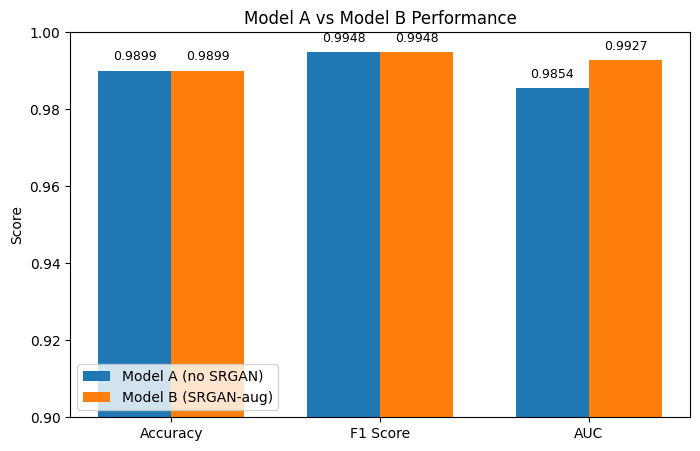

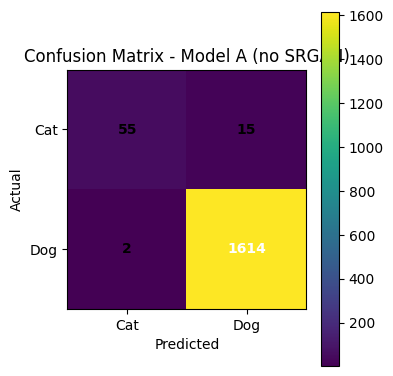

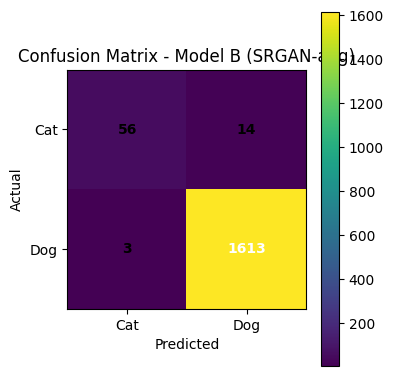

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# 1. Bar chart for metrics
metrics = ["Accuracy", "F1 Score", "AUC"]
modelA_vals = [accA, f1A, aucA]
modelB_vals = [accB, f1B, aucB]

x = np.arange(len(metrics))
width = 0.35

plt.figure(figsize=(8,5))
plt.bar(x - width/2, modelA_vals, width, label="Model A (no SRGAN)")
plt.bar(x + width/2, modelB_vals, width, label="Model B (SRGAN-aug)")

plt.ylim(0.9, 1.0)  # zoom in to highlight differences near 1.0
plt.xticks(x, metrics)
plt.ylabel("Score")
plt.title("Model A vs Model B Performance")
plt.legend()
for i, v in enumerate(modelA_vals):
    plt.text(x[i] - width/2, v + 0.002, f"{v:.4f}", ha="center", va="bottom", fontsize=9)
for i, v in enumerate(modelB_vals):
    plt.text(x[i] + width/2, v + 0.002, f"{v:.4f}", ha="center", va="bottom", fontsize=9)
plt.show()

# Confusion matrix heatmaps for both models
def plot_confusion_matrix(cm, title):
    # cm 2x2 numpy array [[TP_cat, FN_cat],[FP_cat, TP_dog]] in labeling scheme
    plt.figure(figsize=(4,4))
    plt.imshow(cm, interpolation="nearest")
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(2)
    plt.xticks(tick_marks, ["Cat", "Dog"])
    plt.yticks(tick_marks, ["Cat", "Dog"])

    # adding counts in each cell
    thresh = cm.max() / 2.0
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            plt.text(
                j, i,
                str(cm[i, j]),
                ha="center",
                va="center",
                color="white" if cm[i, j] > thresh else "black",
                fontsize=10,
                fontweight="bold",
            )
    plt.ylabel("Actual")
    plt.xlabel("Predicted")
    plt.tight_layout()
    plt.show()

plot_confusion_matrix(cmA, "Confusion Matrix - Model A (no SRGAN)")
plot_confusion_matrix(cmB, "Confusion Matrix - Model B (SRGAN-aug)")


Conclusion: Model B trained with SRGAN-generated 128×128 images achieved identical accuracy (98.99 %) and F1 score (0.9948) to the baseline classifier, while improving AUC from 0.985 to 0.993. This suggests SRGAN augmentation enhanced the model’s discriminative confidence without affecting raw classification rate. The confusion matrices confirm that class-wise performance remains stable, demonstrating SRGAN’s benefit for feature enrichment rather than accuracy gains.